In [1]:
# For Development and debugging:
# Reload modul without restarting the kernel
%load_ext autoreload
%autoreload 2

# 1.- Load libraries and parameters

In [2]:
import tensorflow as tf
import tensorflow_datasets as tfds
import numpy as np
import pandas as pd
pd.options.display.max_columns = None
import os
import sys
import matplotlib.pyplot as plt
import json
import copy
import seaborn as sns
sns.set_theme(style="darkgrid")

# Add EXTERNAL_LIBS_PATH to sys paths (for loading libraries)
EXTERNAL_LIBS_PATH = '/home/hhughes/Documents/Master_Thesis/Project/workspace/libs'
sys.path.insert(1, EXTERNAL_LIBS_PATH)

# Load cortum libs
import NN_interpretability as nn_inter
import Data_augmentation as data_aug
import tfds_utils

# Disable GPU
os.environ["CUDA_VISIBLE_DEVICES"] = "-1"

In [3]:
# Set parameters
params = {}
params['base_path'] = '/home/hhughes/Documents/Master_Thesis/Project/workspace/Interpretability'
params['model_dirs'] = {
    'BL_RIV2_test4': '/home/hhughes/Documents/Master_Thesis/Project/workspace/Interpretability/Models/BL_RIV2_test4',}
params['CMA'] = 'CMA_0'
params['cells'] = ['258520', '208516', '262920', '307720']
params['tf_ds_name'] = 'mpp_ds_normal_dmso_z_score'
params['local_tf_datasets'] = '/data/Master_Thesis_data/datasets/tensorflow_datasets'
params['score_maps_path'] = '/data/Master_Thesis_data/datasets/Score_Maps/VarGrad_IG/BL_RIV2_test4'

plot_dir = os.path.join(params['base_path'], 'Plots')
os.makedirs(plot_dir, exist_ok=True)

# Notas
- BL_t8 mide 08_H3K4ME3 usando 09_SRRM2
- The follow cells are overlaped
    - 277420
    - 195486

In [4]:
black_list = ['277420', '195486']

## 1.1.- Load dataset

In [5]:
# Path where tf datasets are
dataset, ds_info = tfds.load(
    name=params['tf_ds_name'], 
    data_dir=params['local_tf_datasets'], 
    # If False, returns a dictionary with all the features
    as_supervised=False, 
    shuffle_files=False,
    with_info=True)

# Load TFDS metadata
tfds_metadata = tfds_utils.Costum_TFDS_metadata().load_metadata(ds_info.data_dir)
tfds_metadata.keys()

# Load splits
train_data, val_data, test_data = dataset['train'], dataset['validation'], dataset['test']

In [6]:
ds_info.splits

{'test': <SplitInfo num_examples=371, num_shards=32>,
 'train': <SplitInfo num_examples=2962, num_shards=256>,
 'validation': <SplitInfo num_examples=370, num_shards=32>}

In [7]:
ds_info.features

FeaturesDict({
    'image': Tensor(shape=(224, 224, 38), dtype=tf.float32),
    'mapobject_id_cell': Text(shape=(), dtype=tf.string),
    'target': Tensor(shape=(1,), dtype=tf.float64),
})

In [8]:
metadata_df = tfds_metadata['metadata_df']
metadata_df.mapobject_id_cell = metadata_df.mapobject_id_cell.astype(str)
metadata_df

,mapobject_id_cell,mapobject_id,plate_name,well_name,well_pos_y,well_pos_x,tpoint,zplane,label,is_border,plate_name_cell,well_name_cell,well_pos_y_cell,well_pos_x_cell,tpoint_cell,zplane_cell,label_cell,is_border_cell,is_mitotic,is_mitotic_labels,is_polynuclei_HeLa,is_polynuclei_HeLa_labels,is_polynuclei_184A1,is_polynuclei_184A1_labels,cell_cycle,cell_type,perturbation,duration,cell_size,00_DAPI_avg,07_H2B_avg,01_CDK9_pT186_avg,03_CDK9_avg,05_GTF2B_avg,07_SETD1A_avg,08_H3K4me3_avg,09_SRRM2_avg,10_H3K27ac_avg,11_KPNA2_MAX_avg,12_RB1_pS807_S811_avg,13_PABPN1_avg,14_PCNA_avg,15_SON_avg,16_H3_avg,17_HDAC3_avg,19_KPNA1_MAX_avg,20_SP100_avg,21_NCL_avg,01_PABPC1_avg,02_CDK7_avg,03_RPS6_avg,05_Sm_avg,07_POLR2A_avg,09_CCNT1_avg,10_POL2RA_pS2_avg,11_PML_avg,12_YAP1_avg,13_POL2RA_pS5_avg,15_U2SNRNPB_avg,18_NONO_avg,20_ALYREF_avg,21_COIL_avg,00_BG488_avg,00_BG568_avg,00_EU_avg,09_SRRM2_ILASTIK_avg,15_SON_ILASTIK_avg,cell_size_ratio,set
0,263042,263055,plate01,J16,0,0,0,0,4,0,plate01,J16,0,0,0,0,4,0,0.0,NaN,0.0,NaN,0.0,NaN,S,184A1,DMSO,720.0,8401.0,39.610201,282.212391,14.709787,34.481345,122.127518,29.408288,48.079878,56.508154,71.844750,93.999276,108.771761,157.808500,85.331438,43.616172,323.670767,128.386167,134.658031,18.805303,57.414965,26.659837,122.008728,35.669525,62.715594,133.643428,77.230008,283.199741,6.970504,92.891114,280.267874,41.649294,350.631178,356.940289,10.909557,8.600135,1.771257,431.543626,7754.927152,9285.622307,0.553571,train
1,263043,263056,plate01,J16,0,0,0,0,5,0,plate01,J16,0,0,0,0,5,0,0.0,NaN,0.0,NaN,0.0,NaN,S,184A1,DMSO,720.0,12207.0,34.884746,249.743762,14.587963,33.729957,104.787060,25.446742,35.599046,54.977671,48.061287,90.354757,97.722536,145.751775,95.141995,43.284735,308.379265,118.856662,125.728553,14.722060,52.481306,21.451844,122.747143,30.401393,53.993867,124.670275,81.619971,272.290742,9.256049,120.165421,267.314880,39.224038,322.807908,387.219828,10.134157,7.880916,1.749512,461.474236,8818.934136,11041.621938,0.598214,test
2,263044,263057,plate01,J16,0,0,0,0,6,0,plate01,J16,0,0,0,0,6,0,0.0,NaN,0.0,NaN,0.0,NaN,G1,184A1,DMSO,720.0,15734.0,31.429217,184.722779,7.892179,19.263491,81.864454,23.929299,29.536900,39.606383,39.047856,77.348039,12.910413,149.859577,42.855445,25.530594,219.118552,102.575527,125.740665,5.120140,27.724444,24.187370,49.106275,29.276163,35.680201,85.295744,60.602490,232.305672,8.395510,124.383677,193.414682,36.115297,273.154826,252.115717,7.854372,8.116748,1.803605,372.570739,5740.956972,7330.808440,0.723214,train
3,263045,263058,plate01,J16,0,0,0,0,7,0,plate01,J16,0,0,0,0,7,0,0.0,NaN,0.0,NaN,0.0,NaN,S,184A1,DMSO,720.0,15767.0,43.349090,241.460906,18.110119,44.601291,122.976267,40.604674,48.760110,58.076779,77.012867,121.283321,104.755645,159.792550,84.807594,43.961097,319.584115,120.314566,120.470444,25.555966,60.243330,21.220701,140.246102,27.944981,60.354207,169.718381,102.371663,264.648847,10.370258,116.424263,268.396552,43.573547,351.399875,357.762600,10.338172,7.913029,1.773024,369.910382,8085.528636,9678.381810,0.660714,test
4,263047,263060,plate01,J16,0,0,0,0,9,0,plate01,J16,0,0,0,0,9,0,0.0,NaN,0.0,NaN,0.0,NaN,G1,184A1,DMSO,720.0,11930.0,28.164459,149.241408,27.710272,72.874109,148.002903,51.391368,56.976488,116.255474,56.907744,66.943473,97.452245,187.995952,53.530015,60.917580,134.426297,121.980833,121.369045,59.501243,54.852952,26.389251,162.722979,36.026263,79.981471,237.625004,150.247531,255.964144,18.029298,188.560486,192.446750,66.494555,242.252349,174.614508,9.784177,8.899475,1.970130,552.887343,15128.646940,13469.590947,0.625000,train
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3698,266516,266565,plate01,J12,5,4,0,0,44,0,plate01,J12,5,4,0,0,44,0,0.0,NaN,0.0,NaN,0.0,NaN,G2,184A1,normal,NaN,19401.0,38.974759,76.047797,17.563898,36.

In [9]:
channels_df = tfds_metadata['channels_df']
channel_names = [c.split("_")[1:] for c in channels_df.name.values]
channel_names = ["_".join(c) for c in channel_names]
channels_df['channel_name'] = channel_names
channels_df

,original_channel_id,name,train_98_percentile,train_mean_after_clipping,train_stddev_after_clipping,type,TFDS_channel_id,channel_name
0,0.0,00_DAPI,69.300003,29.277029,14.289816,input,0.0,DAPI
1,1.0,07_H2B,310.299988,128.472672,67.600372,input,1.0,H2B
2,2.0,01_CDK9_pT186,46.889076,10.841645,10.662010,input,2.0,CDK9_pT186
3,3.0,03_CDK9,90.797798,24.890778,20.744143,input,3.0,CDK9
4,4.0,05_GTF2B,188.166107,76.841652,45.399426,input,4.0,GTF2B
5,5.0,07_SETD1A,91.989853,20.670820,20.641857,input,5.0,SETD1A
6,6.0,08_H3K4me3,105.921074,34.419682,24.227314,input,6.0,H3K4me3
7,7.0,09_SRRM2,273.374664,39.124294,58.492748,input,7.0,SRRM2
8,8.0,10_H3K27ac,175.104874,59.614319,42.007408,input,8.0,H3K27ac
9,9.0,11_KPNA2_MAX,115.093430,41.293499,23.342470,input,9.0,KPNA2_MAX


In [10]:
# Load model parameters
temp_key = list(params['model_dirs'].keys())[0]
temp_path = os.path.join(params['model_dirs'][temp_key], 'parameters.json')
with open(temp_path, 'r') as file:
    model_params = json.load(file)
print(model_params.keys())

dict_keys(['parameters_file_path', 'external_libs_path', 'model_name', 'custom_model_class', 'pre_training', 'dense_reg', 'conv_reg', 'bias_l2_reg', 'number_of_epochs', 'early_stop_patience', 'loss', 'learning_rate', 'BATCH_SIZE', 'verbose_level', 'model_path', 'basename', 'base_path', 'clean_model_dir', 'tf_ds_name', 'input_channels', 'shuffle_files', 'local_tf_datasets', 'random_horizontal_flipping', 'random_90deg_rotations', 'CenterZoom', 'CenterZoom_mode', 'Random_channel_intencity', 'RCI_dist', 'RCI_mean', 'RCI_stddev', 'RCI_rescale_cte', 'log_path', 'log_file', 'tensorboard', 'seed', 'disable_gpu', 'set_memory_growth', 'cell_size_ratio_mean', 'cell_size_ratio_stddev', 'cell_size_ratio_low_bound'])


In [11]:
# Get input_ids
selected_channels = model_params['input_channels']
n_channels = len(selected_channels)
input_ids = np.array(channels_df.set_index(['name']).loc[selected_channels].TFDS_channel_id.values)
input_ids = np.sort(input_ids.astype(np.int16))
input_channel_names = channels_df.sort_values(by='TFDS_channel_id').set_index('TFDS_channel_id').loc[range(n_channels)].name.values
print(input_ids)

[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32]


## 1.2.- Load Model Data

In [12]:
#models_path = os.path.join(params['base_path'], 'Models', params['model_dir'])
targets_df = pd.DataFrame()
for i, model in enumerate(params['model_dirs'].keys()):
    model_dir = params['model_dirs'][model]
    print('Reading predicted values for model: ', model)
    temp_path = os.path.join(model_dir, 'targets_'+params['CMA']+'.csv')
    with open(temp_path, 'r') as file:
        temp_df = pd.read_csv(file)
    temp_df = temp_df.drop(['y - y_hat'], axis=1)
    prediction_name = 'y_hat'+'_'+model
    temp_df[prediction_name] = temp_df.y_hat
    temp_df = temp_df.drop(['y_hat'], axis=1)
    if i == 0:
        targets_df = temp_df.copy()
    else:
        temp_df = temp_df[['mapobject_id_cell', prediction_name]]
        targets_df = targets_df.merge(temp_df, 
                                      left_on='mapobject_id_cell',
                                      right_on='mapobject_id_cell',
                                      how='left')
targets_df.mapobject_id_cell = targets_df.mapobject_id_cell.astype('string')
mask = targets_df.mapobject_id_cell.isin(np.array(params['cells']))
round(targets_df[mask], 2)

Reading predicted values for model:  BL_RIV2_test4


,y,mapobject_id_cell,set,perturbation,cell_cycle,y_hat_BL_RIV2_test4
18,169.75,258520,train,normal,G1,280.56
2934,513.50,262920,train,normal,G2,497.50
3129,400.17,208516,val,normal,S,418.22
3133,366.16,307720,val,DMSO,G1,331.48


## 1.3.- Divide by low, medium and high TR

In [13]:
# Devide cell in Low TR medium and High
#low_per = targets_df.y.quantile(0.2)
#high_per = targets_df.y.quantile(0.8)
#print(low_per, high_per)
y_std = targets_df.y.std()
y_mean = targets_df.y.mean()
print(y_mean, y_std)
low_per = y_mean-y_std
high_per = y_mean+y_std
print(low_per, high_per)

mask_low = targets_df.y <= low_per
n_low = np.sum((mask_low).values)
mask_avg = (targets_df.y > low_per) & (targets_df.y < high_per)
n_avg = np.sum((mask_avg).values)
mask_high = targets_df.y >= high_per
n_high = np.sum((mask_high).values)
print(n_low, n_avg, n_high)
n_samples = n_low + n_avg + n_high
print(n_low/n_samples, n_avg/n_samples, n_high/n_samples)

# Save TR level
targets_df['TR_Level'] = 'Medium_TR'
temp_idxs = targets_df[mask_low].index
targets_df.loc[temp_idxs, 'TR_Level'] = 'Low_TR'
temp_idxs = targets_df[mask_high].index
targets_df.loc[temp_idxs, 'TR_Level'] = 'High_TR'
targets_df

377.2833369803886 60.71855957335795
316.56477740703065 438.0018965537465
532 2626 545
0.14366729678638943 0.7091547394004861 0.1471779638131245


,y,mapobject_id_cell,set,perturbation,cell_cycle,y_hat_BL_RIV2_test4,TR_Level
0,337.603180,305670,train,DMSO,G1,393.687317,Medium_TR
1,436.179108,248989,train,DMSO,G1,432.883423,Medium_TR
2,344.612427,212764,train,normal,G1,340.201813,Medium_TR
3,397.731262,383254,train,normal,G1,351.875275,Medium_TR
4,251.880371,287059,train,DMSO,G1,375.951721,Low_TR
...,...,...,...,...,...,...,...
3698,400.196350,321028,test,normal,G1,418.039886,Medium_TR
3699,414.214355,194787,test,normal,S,404.132172,Medium_TR
3700,354.966553,259718,test,normal,G1,350.943604,Medium_TR
3701,425.607788,351947,test,normal,G1,344.580719,Medium_TR


## 1.4.- Load score maps info

In [14]:
# load score maps metadata
score_maps_dir = os.path.join(params['score_maps_path'], 'data')
temp_path = os.path.join(params['score_maps_path'], 'score_map_stddev.csv')
score_map_stddev = pd.read_csv(temp_path)
score_map_stddev.mapobject_id_cell = score_map_stddev.mapobject_id_cell.astype('string')
# Add more info
score_map_stddev = score_map_stddev.merge(targets_df,
                                          left_on='mapobject_id_cell',
                                          right_on='mapobject_id_cell',
                                          how='left')
score_map_stddev

,00_DAPI,07_H2B,01_CDK9_pT186,03_CDK9,05_GTF2B,07_SETD1A,08_H3K4me3,09_SRRM2,10_H3K27ac,11_KPNA2_MAX,12_RB1_pS807_S811,13_PABPN1,14_PCNA,15_SON,16_H3,17_HDAC3,19_KPNA1_MAX,20_SP100,21_NCL,01_PABPC1,02_CDK7,03_RPS6,05_Sm,07_POLR2A,09_CCNT1,10_POL2RA_pS2,11_PML,12_YAP1,13_POL2RA_pS5,15_U2SNRNPB,18_NONO,20_ALYREF,21_COIL,Total_cell_stddev,Model,mapobject_id_cell,y,set,perturbation,cell_cycle,y_hat_BL_RIV2_test4,TR_Level
0,0.021754,0.026529,0.034256,0.023857,0.046141,0.049208,0.030868,0.047396,0.017080,0.019650,0.020092,0.039375,0.030082,0.029414,0.024536,0.038465,0.014033,0.022731,0.034001,0.013857,0.023052,0.032130,0.029906,0.032766,0.024469,0.082783,0.020691,0.018230,0.030914,0.032267,0.031785,0.021933,0.035747,394.17322,BL_RIV2_test4,305670,337.603180,train,DMSO,G1,393.687317,Medium_TR
1,0.020187,0.035958,0.050179,0.034767,0.049775,0.042416,0.032182,0.038114,0.016155,0.022010,0.017576,0.034342,0.017154,0.016386,0.025218,0.043587,0.023486,0.017619,0.038527,0.018933,0.023193,0.043794,0.034108,0.026417,0.022609,0.072789,0.015469,0.021051,0.032337,0.031487,0.037531,0.017940,0.026706,556.39990,BL_RIV2_test4,248989,436.179108,train,DMSO,G1,432.883423,Medium_TR
2,0.018894,0.026342,0.027377,0.024820,0.054287,0.034398,0.025356,0.042189,0.019616,0.022974,0.015177,0.037974,0.024109,0.030445,0.036172,0.028468,0.016492,0.018544,0.058972,0.020592,0.017053,0.038208,0.036632,0.022429,0.025903,0.074867,0.023934,0.013758,0.033574,0.039373,0.023196,0.028319,0.039556,298.80084,BL_RIV2_test4,212764,344.612427,train,normal,G1,340.201813,Medium_TR
3,0.018316,0.023719,0.025623,0.026080,0.054002,0.034795,0.026364,0.044107,0.020712,0.020142,0.016356,0.035735,0.024801,0.029357,0.028014,0.025221,0.016634,0.018969,0.057283,0.025418,0.016562,0.036844,0.042424,0.021965,0.029334,0.073191,0.027087,0.016241,0.031316,0.038380,0.025405,0.026298,0.043304,251.42209,BL_RIV2_test4,383254,397.731262,train,normal,G1,351.875275,Medium_TR
4,0.023178,0.033219,0.032957,0.025359,0.039486,0.038332,0.028650,0.042185,0.023298,0.032004,0.016112,0.039168,0.024097,0.020038,0.034207,0.048472,0.023686,0.019167,0.030599,0.022228,0.022879,0.047623,0.027645,0.026608,0.020016,0.094904,0.018076,0.012405,0.029124,0.028067,0.028341,0.020580,0.027289,348.70270,BL_RIV2_test4,287059,251.880371,train,DMSO,G1,375.951721,Low_TR
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3698,0.020526,0.028627,0.042198,0.026439,0.043433,0.048290,0.026681,0.047105,0.016330,0.018655,0.015792,0.035816,0.017752,0.030277,0.025025,0.030446,0.015282,0.023721,0.043803,0.018461,0.017380,0.031951,0.039233,0.033939,0.029440,0.058676,0.025567,0.016517,0.030267,0.036155,0.043080,0.029357,0.033779,598.31280,BL_RIV2_test4,321028,400.196350,test,normal,G1,418.039886,Medium_TR
3699,0.024525,0.026005,0.031450,0.022771,0.045625,0.042689,0.025481,0.049762,0.017878,0.021180,0.018274,0.042016,0.035363,0.029283,0.025315,0.030896,0.020279,0.024166,0.035620,0.017220,0.023780,0.034727,0.029686,0.031254,0.022251,0.078228,0.023598,0.013174,0.032316,0.031853,0.028536,0.023988,0.040812,347.03976,BL_RIV2_test4,194787,414.214355,test,normal,S,404.132172,Medium_TR
3700,0.021166,0.031862,0.028092,0.024746,0.047955,0.031430,0.024385,0.048991,0.019335,0.024752,0.016835,0.038848,0.026474,0.029099,0.034523,0.028373,0.015048,0.019461,0.049381,0.021956,0.015772,0.034107,0.033241,0.021751,0.025975,0.083432,0.026064,0.014208,0.032721,0.039311,0.023372,0.027593,0.039743,249.67712,BL_RIV2_test4,259718,354.966553,test,normal,G1,350.943604,Medium_TR
3701,0.018727,0.023733,0.027946,0.028943,0.052917,0.037200,0.026256,0.041784,0.017151,0.020195,0.017282,0.038032,0.021608,0.036266,0.026807,0.027582,0.016527,0.021582,0.051445,0.023350,0.017243,0.039132,0.041125,0.024260,0.029448,0.076565,0.023174,0.016009,0.028436,0.036073,0.028030,0.023707,0.041462,286.59564,BL_RIV2_test4,351947,425.607788,test,normal,G1,344.580719,Medium_TR


## 1.5.- Load a sample of cells

Opening cell: 258520, 1/4


<ipython-input-15-f83cc77795f7>:24: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cells[cell_id+'_mask'] = cells[cell_id+'_mask'].astype(np.bool)


['train']


Opening cell: 262920, 2/4
['train']


Opening cell: 208516, 3/4
['val']
Opening cell: 307720, 4/4
['val']


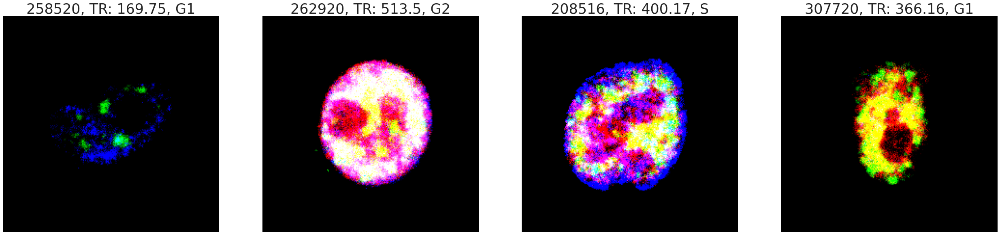

In [15]:
# Load cell, compute its Score map and save it
score_maps_dir = os.path.join(params['score_maps_path'], 'data')
n_cells = len(params['cells'])
plt.figure(figsize=(n_cells*11,10))
dss = [train_data, val_data]
ds_names = ['train', 'val']
cell_count = 0
cells = {}
for ds, dsn in zip(dss, ds_names):
    for cell in ds:
        # get cell id
        cell_id = cell['mapobject_id_cell'].numpy()
        cell_id = str(cell_id.decode())

        if cell_id in params['cells']:
            cell_count += 1
            print('Opening cell: {}, {}/{}'.format(cell_id, cell_count, n_cells))
            
            cells[cell_id+'_img'] = cell['image'].numpy()
            cells[cell_id+'_img'] = cells[cell_id+'_img'][:,:,input_ids].astype(np.float32)
            
            cells[cell_id+'_mask'] = cell['image'].numpy()
            cells[cell_id+'_mask'] = cells[cell_id+'_mask'][:,:,-1]
            cells[cell_id+'_mask'] = cells[cell_id+'_mask'].astype(np.bool)
            
            # load score map
            temp_path = os.path.join(score_maps_dir, cell_id+'.npy')
            cells[cell_id+'_sm'] = np.load(temp_path)
            
            # Plot cells
            temp_img = cells[cell_id+'_img'][:,:,10:13]
            plt.subplot(1, n_cells, cell_count)

            # Get TR
            TR = cell['target'].numpy()[0]
            # get cc
            mask = targets_df.mapobject_id_cell == cell_id
            cc = targets_df[mask].cell_cycle.values[0]
            print(targets_df[mask].set.values)

            nn_inter.plot_cell(img=temp_img, title=cell_id+', TR: '+str(round(TR, 2))+', '+cc, title_fontsize=35)

The next cell contains some funtions needed for the channel similarity analysis.<br>
TODO: Clean this code, comment it and put it in a library.

In [16]:
from scipy import ndimage
from scipy.spatial.distance import directed_hausdorff

def compute_channel_difference_matrix(score_map, cell_mask, metric='mae'):
    n_channels = score_map.shape[-1]
    dist_mtx = np.zeros((n_channels, n_channels))
    N = cell_mask.sum()
    for i in range(n_channels):
        for j in range(n_channels):
            if metric == 'mae':
                dist_mtx[i,j] = (1 / N) * np.sum(np.abs(score_map[:,:,i] - score_map[:,:,j]))
            elif metric == 'hausdorff':
                dist_mtx[i,j] = directed_hausdorff(score_map[:,:,i], score_map[:,:,j])[0]
    
    # normalize values
    norm_param = dist_mtx.sum()
    dist_mtx /= norm_param
    
    return dist_mtx

def apply_gaussin_filter(img=None,  sigma=1):
    return ndimage.gaussian_filter(img, sigma)

def standardize_img(img, img_mask):
    channel_mean = img[img_mask].mean(axis=0)
    channel_stddev = img[img_mask].std(axis=0)

    img[img_mask] = img[img_mask] - channel_mean
    img[img_mask] = img[img_mask] / channel_stddev
    
    return img

def apply_percentile_clipping(img, img_mask, p=98):

    percentile_vector = np.percentile(img[img_mask], q=p, axis=0)

    n_channels = img.shape[-1]
    for c in range(n_channels):
        mask = (img[:,:,c] >= percentile_vector[c])
        img[:,:,c][mask] = percentile_vector[c]
        
    return img

def get_channels_dist(c1, c2, cell_mask, metric):
    N = cell_mask.sum()
    if metric == 'mae':
        return (1 / N) * np.sum(np.abs(c1 - c2))
    elif metric == 'hausdorff':
        return directed_hausdorff(c1, c2)[0]
    
def get_score_map_similarity(temp_score, temp_cell_img, cell_mask, metric='mae'):
    INF = np.inf
    n_channels =  temp_score.shape[-1]
    # similarity between score_map channels and score_map channels
    top_sim_sm_channel_id_dict = {}
    top_sim_sm_channel_dist_dict = {}
    # similarity between score_map channels and cell_img channels
    top_sim_channel_id_dict = {}
    most_sim_channel_dist = {}
    # dataframes to store score map channel dist
    temp_sm_to_sm = {}
    temp_sm_to_ci = {}
    
    for key in range(3):
        top_sim_sm_channel_id_dict[key] = []
        top_sim_sm_channel_dist_dict[key] = []
        
        top_sim_channel_id_dict[key] = []
        most_sim_channel_dist[key] = []
    
    for i in range(n_channels):
        sm_chanel_dist = []
        chanel_dist = []
        for j in range(n_channels):
            if i == j:
                # distance between a channel and itself is 0, therefore assign it INF
                sm_chanel_dist.append(INF)
            else:
                sm_chanel_dist.append(get_channels_dist(temp_score[:,:,i], temp_score[:,:,j], cell_mask, metric))
            # distances between the score_map channel j and cell_img channels
            chanel_dist.append(get_channels_dist(temp_score[:,:,i], temp_cell_img[:,:,j], cell_mask, metric))
            
        for key in range(3):
            # save the most similar score_map channel to channel i
            top_sim_sm_channel_id_dict[key].append(np.argsort(sm_chanel_dist)[key])
            top_sim_sm_channel_dist_dict[key].append(np.sort(sm_chanel_dist)[key])
            # save the most similar cell_img channel to score_map channel i
            top_sim_channel_id_dict[key].append(np.argsort(chanel_dist)[key])
            most_sim_channel_dist[key].append(np.sort(chanel_dist)[key])
    
    columns = [cn+'_idx' for cn in input_channel_names] + [cn+'_dist' for cn in input_channel_names]
    for key in range(3):
        temp_arr = np.array(top_sim_sm_channel_id_dict[key] + top_sim_sm_channel_dist_dict[key]).reshape((1, -1))
        temp_sm_to_sm[key] = pd.DataFrame(temp_arr, columns=columns)
        temp_arr = np.array(top_sim_channel_id_dict[key] + most_sim_channel_dist[key]).reshape((1, -1))
        temp_sm_to_ci[key] = pd.DataFrame(temp_arr, columns=columns)
    
    return temp_sm_to_sm, temp_sm_to_ci

def move_img_into_0_1(temp_img, temp_mask):
    min_vals = temp_img[temp_mask].min(axis=0)
    max_vals = temp_img[temp_mask].max(axis=0)
    
    temp_img[temp_mask] = (temp_img[temp_mask] - min_vals) / (max_vals - min_vals)
    
    return temp_img

# 2.- Compute distance (similarity) between score maps channels and score maps channels, and score maps channels and cell image channels using the MAE

This take like 2 hours and it was computed in my local machine and not in the server.

In [19]:
metric = 'mae'
top_sm_to_sm_dfs = {}
top_sm_to_ci_dfs = {}
for key in range(3):
    top_sm_to_sm_dfs[key] = pd.DataFrame()
    top_sm_to_ci_dfs[key] = pd.DataFrame()

#mask = tfds_metadata['metadata_df'].set == 'test'
#params['cells'] = tfds_metadata['metadata_df'][~mask].mapobject_id_cell.unique().astype('str')
params['cells'] = metadata_df.mapobject_id_cell.unique().astype('str')


# Load cell, compute its Score map and save it
score_maps_dir = os.path.join(params['score_maps_path'], 'data')
#params['cells'] = big_cells
n_cells = len(params['cells'])
dss = [train_data, val_data, test_data]
ds_names = ['train', 'val', 'test']
cell_count = 0
for ds, dsn in zip(dss, ds_names):
    for cell in ds:
        # get cell id
        cell_id = cell['mapobject_id_cell'].numpy()
        cell_id = str(cell_id.decode())

        if cell_id in params['cells']:
            cell_count += 1
            print('Loading cell: {}, {}/{}'.format(cell_id, cell_count, n_cells))
            
            cell_img = cell['image'].numpy()
            cell_img = cell_img[:,:,input_ids].astype(np.float32)
            
            cell_mask = cell['image'].numpy()
            cell_mask = cell_mask[:,:,-1]
            cell_mask = cell_mask.astype(np.bool)
            
            # load score map
            temp_path = os.path.join(score_maps_dir, cell_id+'.npy')
            score_map = np.load(temp_path)
            
            # get channel similarity
            # preprocess
            score_map = standardize_img(score_map, cell_mask)
            cell_img = standardize_img(cell_img, cell_mask)
            
            # get sim
            smsm_dfs, smci_dfs = get_score_map_similarity(score_map, cell_img, cell_mask, metric)
            for key in range(3):
                smsm_dfs[key]['mapobject_id_cell'] = cell_id
                smci_dfs[key]['mapobject_id_cell'] = cell_id
                
                top_sm_to_sm_dfs[key] = pd.concat((top_sm_to_sm_dfs[key], smsm_dfs[key]), axis=0, ignore_index=True)
                top_sm_to_ci_dfs[key] = pd.concat((top_sm_to_ci_dfs[key], smci_dfs[key]), axis=0, ignore_index=True)

Loading cell: 305670, 1/3332
Loading cell: 248989, 2/3332
Loading cell: 212764, 3/3332
Loading cell: 383254, 4/3332
Loading cell: 287059, 5/3332
Loading cell: 226855, 6/3332
Loading cell: 366430, 7/3332
Loading cell: 266507, 8/3332
Loading cell: 337246, 9/3332
Loading cell: 235351, 10/3332
Loading cell: 305662, 11/3332
Loading cell: 307724, 12/3332
Loading cell: 221647, 13/3332
Loading cell: 194797, 14/3332
Loading cell: 260099, 15/3332
Loading cell: 321007, 16/3332
Loading cell: 215865, 17/3332
Loading cell: 305667, 18/3332
Loading cell: 258520, 19/3332
Loading cell: 195221, 20/3332
Loading cell: 350656, 21/3332
Loading cell: 257458, 22/3332
Loading cell: 359335, 23/3332
Loading cell: 195549, 24/3332
Loading cell: 329080, 25/3332
Loading cell: 202822, 26/3332
Loading cell: 359020, 27/3332
Loading cell: 319175, 28/3332
Loading cell: 256525, 29/3332
Loading cell: 287403, 30/3332
Loading cell: 373523, 31/3332
Loading cell: 351026, 32/3332
Loading cell: 319183, 33/3332
Loading cell: 26854

In [29]:
# Save data
#for key in range(3):
#    temp_name = os.path.join('./Data', 'top_'+str(key)+'_sm_to_ci_dfs_2.csv')
#    with open(temp_name, 'w') as file:
#        top_sm_to_ci_dfs[key].to_csv(file, index=False)
        
#    temp_name = os.path.join('./Data', 'top_'+str(key)+'_sm_to_sm_dfs_2.csv')
#    with open(temp_name, 'w') as file:
#        top_sm_to_sm_dfs[key].to_csv(file, index=False)

In [17]:

metric = 'mae'
top_sm_to_sm_dfs = {}
top_sm_to_ci_dfs = {}
for key in range(3):
    top_sm_to_sm_dfs[key] = pd.DataFrame()
    top_sm_to_ci_dfs[key] = pd.DataFrame()
    
for key in range(3):
    temp_name = os.path.join('./Data', 'top_'+str(key)+'_sm_to_ci_dfs_2.csv')
    with open(temp_name, 'r') as file:
        top_sm_to_ci_dfs[key] = pd.read_csv(file)
        
    temp_name = os.path.join('./Data', 'top_'+str(key)+'_sm_to_sm_dfs.csv')
    with open(temp_name, 'r') as file:
        top_sm_to_sm_dfs[key] = pd.read_csv(file)

In [18]:
top_sm_to_sm_dfs[0]

,00_DAPI_idx,07_H2B_idx,01_CDK9_pT186_idx,03_CDK9_idx,05_GTF2B_idx,07_SETD1A_idx,08_H3K4me3_idx,09_SRRM2_idx,10_H3K27ac_idx,11_KPNA2_MAX_idx,12_RB1_pS807_S811_idx,13_PABPN1_idx,14_PCNA_idx,15_SON_idx,16_H3_idx,17_HDAC3_idx,19_KPNA1_MAX_idx,20_SP100_idx,21_NCL_idx,01_PABPC1_idx,02_CDK7_idx,03_RPS6_idx,05_Sm_idx,07_POLR2A_idx,09_CCNT1_idx,10_POL2RA_pS2_idx,11_PML_idx,12_YAP1_idx,13_POL2RA_pS5_idx,15_U2SNRNPB_idx,18_NONO_idx,20_ALYREF_idx,21_COIL_idx,00_DAPI_dist,07_H2B_dist,01_CDK9_pT186_dist,03_CDK9_dist,05_GTF2B_dist,07_SETD1A_dist,08_H3K4me3_dist,09_SRRM2_dist,10_H3K27ac_dist,11_KPNA2_MAX_dist,12_RB1_pS807_S811_dist,13_PABPN1_dist,14_PCNA_dist,15_SON_dist,16_H3_dist,17_HDAC3_dist,19_KPNA1_MAX_dist,20_SP100_dist,21_NCL_dist,01_PABPC1_dist,02_CDK7_dist,03_RPS6_dist,05_Sm_dist,07_POLR2A_dist,09_CCNT1_dist,10_POL2RA_pS2_dist,11_PML_dist,12_YAP1_dist,13_POL2RA_pS5_dist,15_U2SNRNPB_dist,18_NONO_dist,20_ALYREF_dist,21_COIL_dist,mapobject_id_cell
0,5.0,28.0,25.0,13.0,28.0,23.0,5.0,11.0,9.0,31.0,2.0,7.0,25.0,11.0,8.0,11.0,11.0,26.0,21.0,22.0,23.0,22.0,21.0,5.0,5.0,11.0,17.0,6.0,9.0,31.0,5.0,29.0,11.0,0.405219,0.440696,0.384419,0.562785,0.493709,0.267908,0.333786,0.303796,0.450093,0.406051,0.471785,0.303796,0.534413,0.386864,0.473244,0.345672,0.448311,0.514960,0.613316,0.645012,0.356531,0.514959,0.514959,0.267908,0.461530,0.339985,0.514960,0.535133,0.434142,0.391552,0.325079,0.391552,0.465996,305670
1,27.0,7.0,30.0,30.0,18.0,7.0,2.0,25.0,14.0,15.0,1.0,7.0,8.0,29.0,8.0,9.0,28.0,26.0,4.0,31.0,7.0,22.0,30.0,5.0,23.0,7.0,17.0,15.0,29.0,14.0,2.0,8.0,22.0,0.715245,0.524107,0.433902,0.565702,0.420196,0.406616,0.460249,0.386397,0.340212,0.484942,0.556910,0.408200,0.443777,0.490941,0.340212,0.484942,0.566835,0.502036,0.420196,0.610293,0.556012,0.592275,0.556247,0.443812,0.568539,0.386397,0.502036,0.654852,0.473155,0.425458,0.433902,0.362386,0.658061,248989
2,11.0,9.0,4.0,11.0,32.0,13.0,24.0,15.0,28.0,28.0,4.0,25.0,8.0,5.0,8.0,11.0,11.0,26.0,21.0,22.0,4.0,18.0,21.0,24.0,5.0,11.0,17.0,22.0,9.0,31.0,24.0,29.0,22.0,0.443191,0.335257,0.430097,0.433740,0.364808,0.296506,0.402283,0.417529,0.338937,0.330945,0.416470,0.319353,0.346135,0.296506,0.360026,0.413157,0.522292,0.441816,0.265801,0.374826,0.542396,0.265801,0.292795,0.388941,0.376017,0.319353,0.441816,0.419010,0.330945,0.370339,0.405946,0.370339,0.344569,212764
3,11.0,9.0,4.0,5.0,18.0,13.0,27.0,15.0,14.0,12.0,29.0,25.0,9.0,5.0,12.0,25.0,22.0,26.0,21.0,18.0,4.0,18.0,4.0,22.0,5.0,11.0,17.0,22.0,14.0,10.0,22.0,29.0,22.0,0.407947,0.395520,0.498664,0.391623,0.326244,0.281412,0.404639,0.409690,0.400013,0.361744,0.380928,0.331326,0.361744,0.281412,0.365562,0.406255,0.434850,0.412396,0.228989,0.448234,0.456565,0.228989,0.338645,0.359602,0.289730,0.331326,0.412396,0.370587,0.401572,0.380928,0.472615,0.409455,0.351137,383254
4,11.0,7.0,30.0,8.0,28.0,7.0,30.0,5.0,31.0,15.0,25.0,5.0,8.0,11.0,29.0,9.0,28.0,26.0,4.0,4.0,11.0,22.0,6.0,7.0,13.0,23.0,17.0,14.0,29.0,28.0,6.0,8.0,11.0,0.746760,0.433503,0.420532,0.659118,0.586032,0.360169,0.381349,0.360169,0.493308,0.506764,0.539841,0.372159,0.592106,0.479644,0.552738,0.506764,0.617194,0.531281,0.605540,0.710246,0.557289,0.648728,0.516381,0.391954,0.538571,0.394360,0.531281,0.713914,0.491053,0.491053,0.381349,0.493308,0.567560,287059
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3327,4.0,29.0,4.0,5.0,12.0,13.0,24.0,29.0,12.0,1.0,4.0,5.0,8.0,5.0,8.0,28.0,1.0,26.0,21.0,18.0,4.0,18.0,6.0,24.0,5.0,6.0,17.0,6.0,8.0,1.0,11.0,11.0,21.0,0.576877,0.376641,0.499777,0.386918,0.440788,0.241296,0.436040,0.400649,0.325382,0.402184,0.525377,0.411279,0.325382,0.241296,0.349004,0.464606,0.643878,0.492211,0.343764,0.470514,0.555743,0.343764,0.452710,0.447000,0.337567,0.441335,0.492211,0.500521,0.354891,0.376641,0.452612,0.467547,0.460162,306902
3328,4.0,9.0,4.0,

## 2.1.- Similarity between score_maps channels and cell_image channels

[13 17  7 18 19 26]


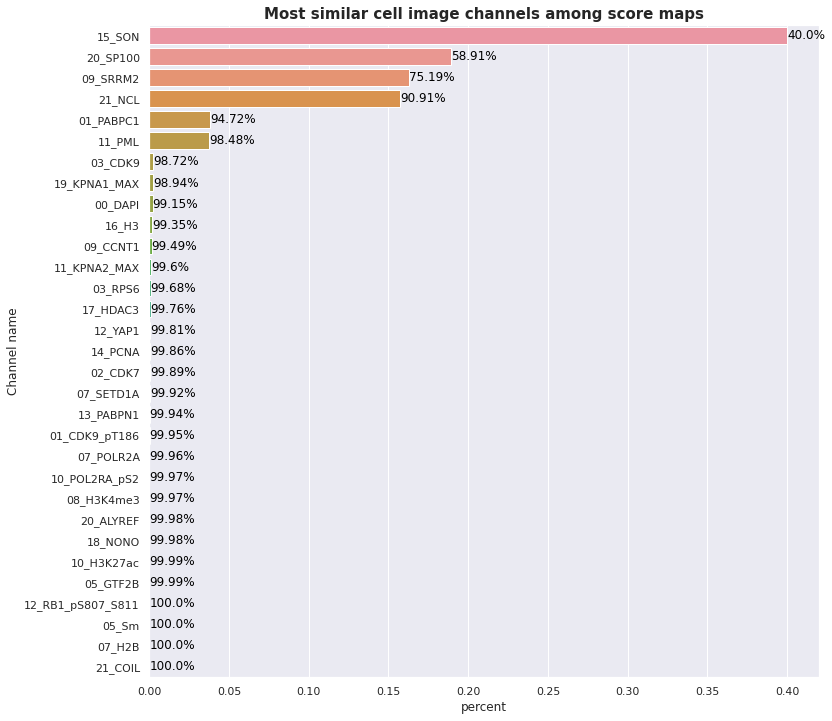

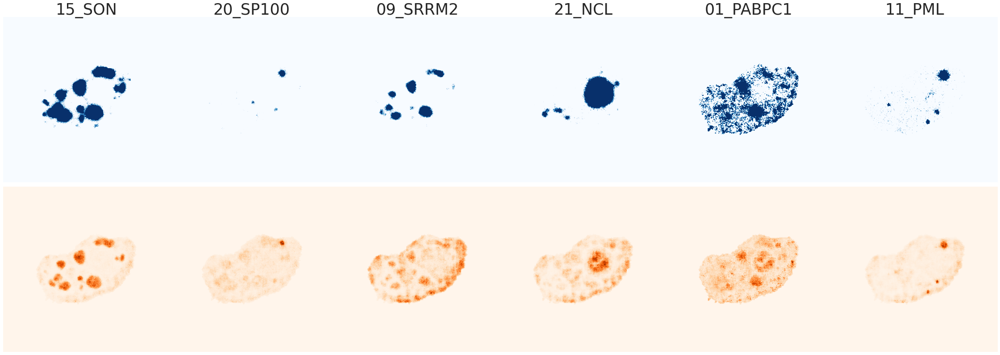

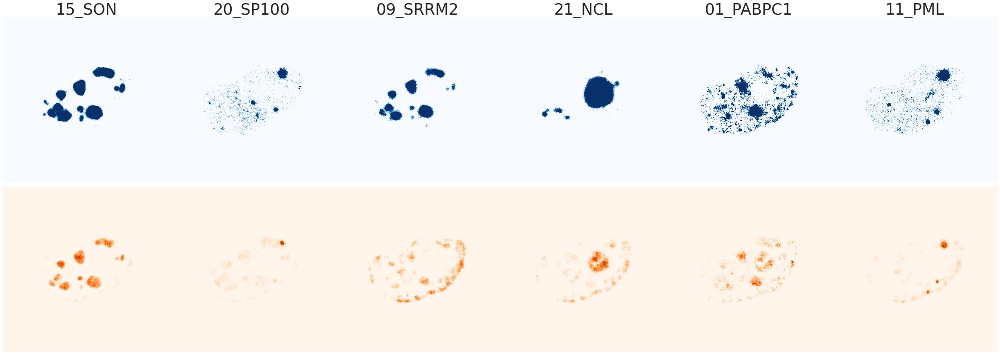

In [19]:
def get_channel_counts(data):
    # Channels sorted by similarity counts
    columns = [cn+'_idx' for cn in input_channel_names] + ['mapobject_id_cell']
    data = data[columns].set_index('mapobject_id_cell').stack()
    data = data.reset_index()
    data.columns = ['mapobject_id_cell', 'channel', 'idx']

    channel_counts = data['idx'].value_counts().reset_index().copy()
    channel_counts.columns = ['TFDS_channel_id', 'count']
    total_counts = channel_counts['count'].sum()
    channel_counts['percent'] = channel_counts['count'] / total_counts
    channel_counts['cum_percent'] = channel_counts['count'].cumsum() / total_counts
    channel_counts = channel_counts.merge(channels_df[['TFDS_channel_id', 'name']],
                                 left_on='TFDS_channel_id',
                                 right_on='TFDS_channel_id',
                                 how='left'
                                )
    return channel_counts
    
data = top_sm_to_ci_dfs[0].copy()
channel_counts = get_channel_counts(data)
    
plt.figure(figsize=(12,12))
g = sns.barplot(data=channel_counts,
            y='name',
            x='percent',
            orient="h"
           )
plt.title('Most similar cell image channels among score maps', fontweight="bold", fontsize=15)
plt.ylabel('Channel name')
# add per cents
for _, row in channel_counts.iterrows():
    text = str(round(100 * row.cum_percent,2))+'%'
    g.text(row['percent'], row.name, text, color='black', ha="left", va="center")
    
# plot top channels
# take one cell from the sample
cell_id = '258520'
score_map = copy.deepcopy(cells[cell_id+'_sm'])
cell_img = copy.deepcopy(cells[cell_id+'_img'])
cell_mask = cells[cell_id+'_mask']
# select the most important channels
mask = channel_counts['cum_percent'] <= 0.985
names_channels_2_plot = channel_counts[mask].name.values
channels_2_plot = channels_df.set_index('name').loc[names_channels_2_plot].TFDS_channel_id.astype(np.int16).values
print(channels_2_plot)

# Original img and score map
nn_inter.plot_VarGrad_IG_2(img=cell_img,
                           img_mask=cell_mask,
                           score_maps={'BL_RIV2_test4': score_map},
                           top_percent=1,
                           channels_df=channels_df,
                           img_size=(7,7),
                           score_map_same_sacale=False,
                           channels_2_plot=channels_2_plot,
                           plot_overlap=False,
                           plot_colorbar=False,
                           plot_name=None#'./Plots/BL_VarGrad_'+cell+'_0_5.png'
                            )

# preprocessed image and score map
score_map = standardize_img(score_map, cell_mask)
cell_img = standardize_img(cell_img, cell_mask)
nn_inter.plot_VarGrad_IG_2(img=cell_img,
                           img_mask=cell_mask,
                           score_maps={'BL_RIV2_test4': score_map},
                           top_percent=1,
                           channels_df=channels_df,
                           img_size=(7,7),
                           score_map_same_sacale=False,
                           channels_2_plot=channels_2_plot,
                           plot_overlap=False,
                           plot_colorbar=False,
                           plot_name=None#'./Plots/BL_VarGrad_'+cell+'_0_5.png'
                            )

[25  4  7 18 11  5 13 17 26]


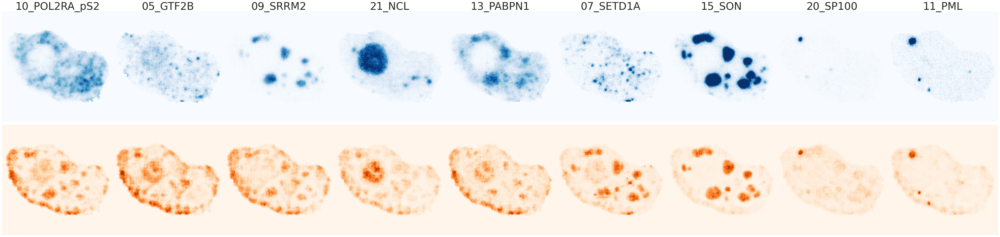

In [20]:
# preprocessed image and score map
cell_id = '258520'
score_map = copy.deepcopy(cells[cell_id+'_sm'])
cell_img = copy.deepcopy(cells[cell_id+'_img'])
cell_mask = cells[cell_id+'_mask']

names_channels_2_plot = ['10_POL2RA_pS2', '05_GTF2B', '09_SRRM2', '21_NCL', '13_PABPN1', '07_SETD1A', '15_SON', '20_SP100', '11_PML']
channels_2_plot = channels_df.set_index('name').loc[names_channels_2_plot].TFDS_channel_id.astype(np.int16).values
print(channels_2_plot)

#score_map = standardize_img(score_map, cell_mask)
#cell_img = standardize_img(cell_img, cell_mask)
score_map = move_img_into_0_1(score_map, cell_mask)
cell_img = move_img_into_0_1(cell_img, cell_mask)

l_idx = 40
h_idx = 184
score_map = np.flip(score_map[l_idx:h_idx, l_idx:h_idx,:], axis=1)
cell_img = np.flip(cell_img[l_idx:h_idx, l_idx:h_idx,:], axis=1)
cell_mask = np.flip(cell_mask[l_idx:h_idx, l_idx:h_idx], axis=1)

nn_inter.plot_VarGrad_IG_2(img=cell_img,
                           img_mask=cell_mask,
                           score_maps={'BL_RIV2_test4': score_map},
                           top_percent=1,
                           channels_df=channels_df,
                           img_size=(7,7),
                           score_map_same_sacale=False,
                           channels_2_plot=channels_2_plot,
                           plot_overlap=False,
                           plot_colorbar=False,
                           plot_name='./temp.jpg'
                            )

[ 7 13 17 26 19 18]


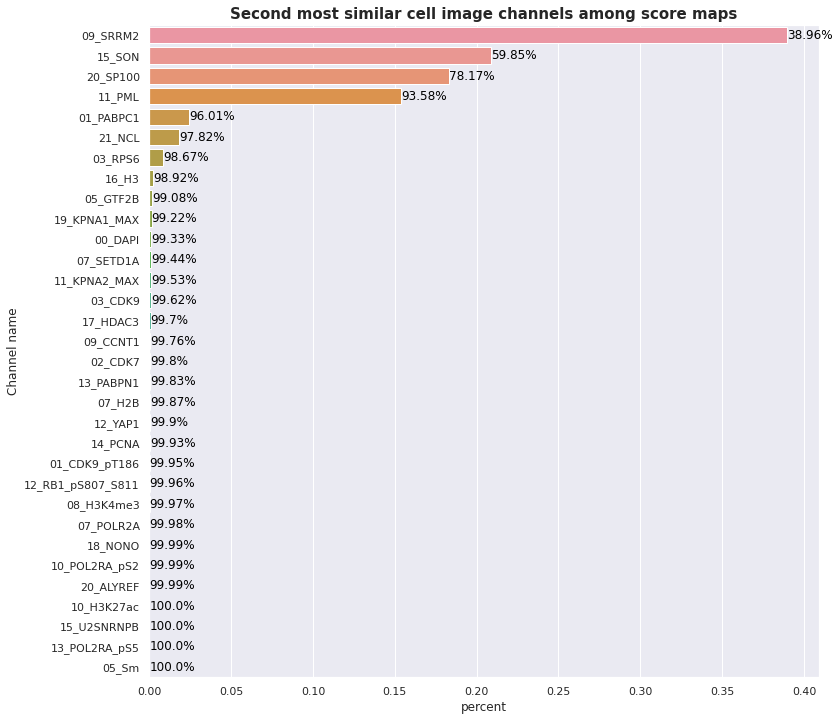

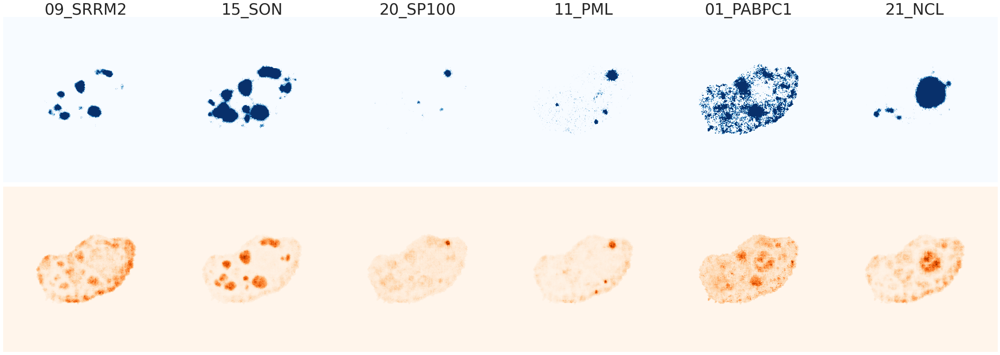

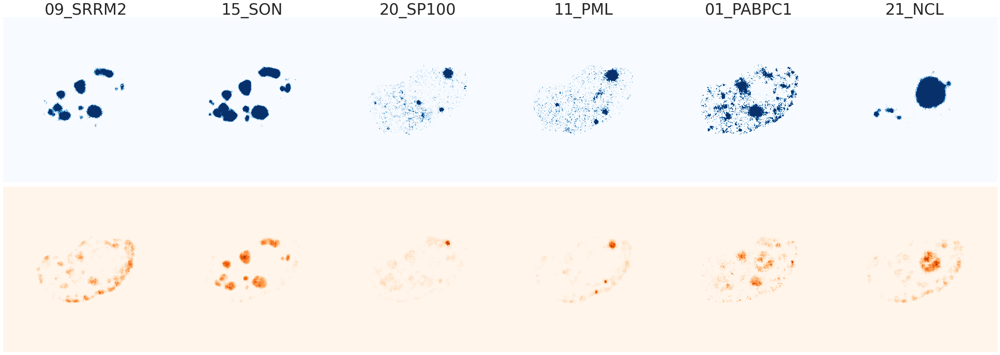

In [21]:
# Channels sorted by similarity counts
columns = [cn+'_idx' for cn in input_channel_names] + ['mapobject_id_cell']
temp_df = top_sm_to_ci_dfs[1].copy()
temp_df = temp_df[columns].set_index('mapobject_id_cell').stack()
temp_df = temp_df.reset_index()
temp_df.columns = ['mapobject_id_cell', 'channel', 'idx']

channel_counts = temp_df['idx'].value_counts().reset_index().copy()
channel_counts.columns = ['TFDS_channel_id', 'count']
total_counts = channel_counts['count'].sum()
channel_counts['percent'] = channel_counts['count'] / total_counts
channel_counts['cum_percent'] = channel_counts['count'].cumsum() / total_counts
channel_counts = channel_counts.merge(channels_df[['TFDS_channel_id', 'name']],
                             left_on='TFDS_channel_id',
                             right_on='TFDS_channel_id',
                             how='left'
                            )

plt.figure(figsize=(12,12))
g = sns.barplot(data=channel_counts,
            y='name',
            x='percent',
            orient="h"
           )
plt.title('Second most similar cell image channels among score maps', fontweight="bold", fontsize=15)
plt.ylabel('Channel name')
# add per cents
for _, row in channel_counts.iterrows():
    text = str(round(100 * row.cum_percent,2))+'%'
    g.text(row['percent'], row.name, text, color='black', ha="left", va="center")
    
# plot top channels
# take one cell from the sample
cell_id = '258520'
score_map = copy.deepcopy(cells[cell_id+'_sm'])
cell_img = copy.deepcopy(cells[cell_id+'_img'])
cell_mask = cells[cell_id+'_mask']
# select the most important channels
mask = channel_counts['cum_percent'] <= 0.98
names_channels_2_plot = channel_counts[mask].name.values
channels_2_plot = channels_df.set_index('name').loc[names_channels_2_plot].TFDS_channel_id.astype(np.int16).values
print(channels_2_plot)

# Original img and score map
nn_inter.plot_VarGrad_IG_2(img=cell_img,
                           img_mask=cell_mask,
                           score_maps={'BL_RIV2_test4': score_map},
                           top_percent=1,
                           channels_df=channels_df,
                           img_size=(7,7),
                           score_map_same_sacale=False,
                           channels_2_plot=channels_2_plot,
                           plot_overlap=False,
                           plot_colorbar=False,
                           plot_name=None#'./Plots/BL_VarGrad_'+cell+'_0_5.png'
                            )

# preprocessed image and score map
score_map = standardize_img(score_map, cell_mask)
cell_img = standardize_img(cell_img, cell_mask)
nn_inter.plot_VarGrad_IG_2(img=cell_img,
                           img_mask=cell_mask,
                           score_maps={'BL_RIV2_test4': score_map},
                           top_percent=1,
                           channels_df=channels_df,
                           img_size=(7,7),
                           score_map_same_sacale=False,
                           channels_2_plot=channels_2_plot,
                           plot_overlap=False,
                           plot_colorbar=False,
                           plot_name=None#'./Plots/BL_VarGrad_'+cell+'_0_5.png'
                            )

[17 26 11 13 19  7 18 31  5  2 21  3 14 24]


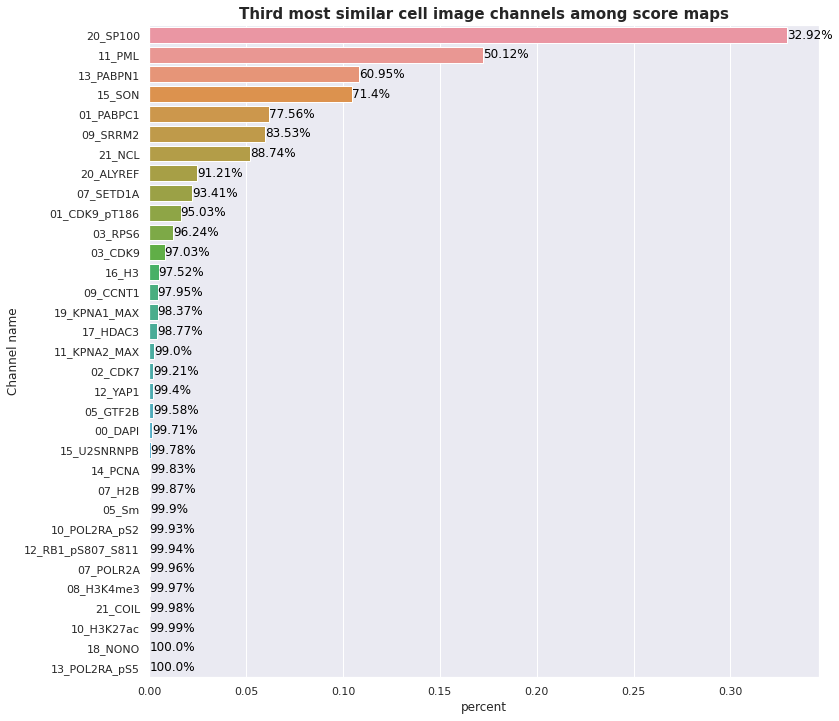

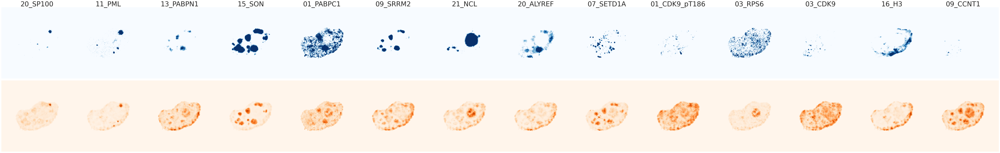

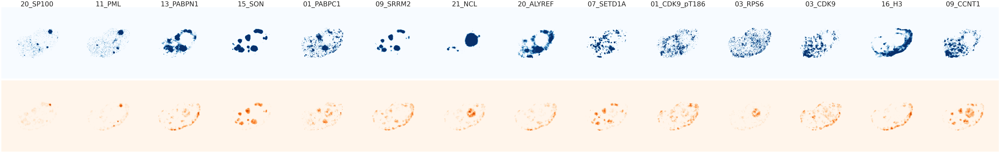

In [22]:
# Channels sorted by similarity counts
columns = [cn+'_idx' for cn in input_channel_names] + ['mapobject_id_cell']
temp_df = top_sm_to_ci_dfs[2].copy()
temp_df = temp_df[columns].set_index('mapobject_id_cell').stack()
temp_df = temp_df.reset_index()
temp_df.columns = ['mapobject_id_cell', 'channel', 'idx']

channel_counts = temp_df['idx'].value_counts().reset_index().copy()
channel_counts.columns = ['TFDS_channel_id', 'count']
total_counts = channel_counts['count'].sum()
channel_counts['percent'] = channel_counts['count'] / total_counts
channel_counts['cum_percent'] = channel_counts['count'].cumsum() / total_counts
channel_counts = channel_counts.merge(channels_df[['TFDS_channel_id', 'name']],
                             left_on='TFDS_channel_id',
                             right_on='TFDS_channel_id',
                             how='left'
                            )

plt.figure(figsize=(12,12))
g = sns.barplot(data=channel_counts,
            y='name',
            x='percent',
            orient="h"
           )
plt.title('Third most similar cell image channels among score maps', fontweight="bold", fontsize=15)
plt.ylabel('Channel name')
# add per cents
for _, row in channel_counts.iterrows():
    text = str(round(100 * row.cum_percent,2))+'%'
    g.text(row['percent'], row.name, text, color='black', ha="left", va="center")
    
# plot top channels
# take one cell from the sample
cell_id = '258520'
score_map = copy.deepcopy(cells[cell_id+'_sm'])
cell_img = copy.deepcopy(cells[cell_id+'_img'])
cell_mask = cells[cell_id+'_mask']
# select the most important channels
mask = channel_counts['cum_percent'] <= 0.98
names_channels_2_plot = channel_counts[mask].name.values
channels_2_plot = channels_df.set_index('name').loc[names_channels_2_plot].TFDS_channel_id.astype(np.int16).values
print(channels_2_plot)

# Original img and score map
nn_inter.plot_VarGrad_IG_2(img=cell_img,
                           img_mask=cell_mask,
                           score_maps={'BL_RIV2_test4': score_map},
                           top_percent=1,
                           channels_df=channels_df,
                           img_size=(7,7),
                           score_map_same_sacale=False,
                           channels_2_plot=channels_2_plot,
                           plot_overlap=False,
                           plot_colorbar=False,
                           plot_name=None#'./Plots/BL_VarGrad_'+cell+'_0_5.png'
                            )

# preprocessed image and score map
score_map = standardize_img(score_map, cell_mask)
cell_img = standardize_img(cell_img, cell_mask)
nn_inter.plot_VarGrad_IG_2(img=cell_img,
                           img_mask=cell_mask,
                           score_maps={'BL_RIV2_test4': score_map},
                           top_percent=1,
                           channels_df=channels_df,
                           img_size=(7,7),
                           score_map_same_sacale=False,
                           channels_2_plot=channels_2_plot,
                           plot_overlap=False,
                           plot_colorbar=False,
                           plot_name=None#'./Plots/BL_VarGrad_'+cell+'_0_5.png'
                            )

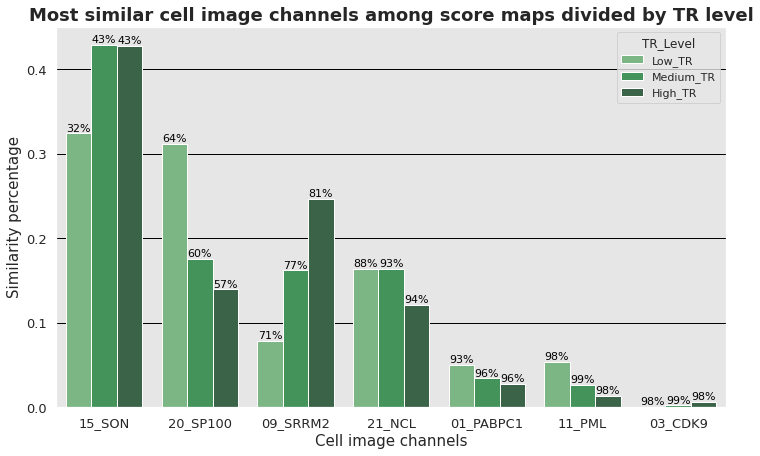

In [26]:
sns.set_style("darkgrid", {"axes.facecolor": ".9"})

n_top_channels_to_show = 7
# Separated by cc
temp_df = top_sm_to_ci_dfs[0].copy()
temp_df.mapobject_id_cell = temp_df.mapobject_id_cell.astype(str)

columns = [cn+'_idx' for cn in input_channel_names] + ['mapobject_id_cell']
temp_df = temp_df[columns].set_index('mapobject_id_cell').stack().reset_index()
temp_df.columns = ['mapobject_id_cell', 'sm_channel_name', 'ci_channel_idx']
temp_df = temp_df.merge(score_map_stddev[['mapobject_id_cell', 'cell_cycle', 'TR_Level', 'set']],
                  left_on='mapobject_id_cell',
                   right_on='mapobject_id_cell',
                   how='left'
                  )
mask = temp_df.set == 'test'
temp_df = temp_df[mask]

# compute the order to plot the ci_channels
total_channel_counts = temp_df[['ci_channel_idx']].value_counts().reset_index()
total_channel_counts.columns = ['ci_channel_idx', 'total_channel_count']

TR_levels = ['High_TR', 'Medium_TR', 'Low_TR']

# compute the perchannel count divided by TR_level
channel_counts_per_TRL = pd.DataFrame()
for i, trl in enumerate(TR_levels):
    mask = (temp_df.TR_Level == trl)
    channel_counts = temp_df[mask]['ci_channel_idx'].copy()
    channel_counts = channel_counts.value_counts().reset_index()
    channel_counts.columns = ['ci_channel_idx', 'count']
    total_trl_counts = channel_counts['count'].values.sum()
    channel_counts['trl_channel_percent'] = channel_counts['count'] / total_trl_counts
    channel_counts = channel_counts.merge(total_channel_counts, left_on='ci_channel_idx', right_on='ci_channel_idx', how='left')
    channel_counts = channel_counts.sort_values(by='total_channel_count', ascending=False).reset_index().drop('index', axis=1)
    channel_counts['trl_channel_cum_percent'] = channel_counts['trl_channel_percent'].cumsum()
    channel_counts['TR_Level'] = trl
    channel_counts['TR_Level_num'] = i
    channel_counts_per_TRL = pd.concat((channel_counts_per_TRL, channel_counts), axis=0, ignore_index=True)

# To plot the channels ordered, compute the perchannel counts and sort accordingly
channel_counts_per_TRL = channel_counts_per_TRL.sort_values(by=['total_channel_count', 'TR_Level_num'], ascending=False)
# get the top channels
temp2_df = channel_counts_per_TRL[['ci_channel_idx', 'total_channel_count']].groupby('ci_channel_idx').mean()
temp2_df = temp2_df.sort_values(by='total_channel_count', ascending=False).reset_index()
top_channel_idxs = temp2_df['ci_channel_idx'].values[0:n_top_channels_to_show]

# select only the top channels
mask = channel_counts_per_TRL.ci_channel_idx.isin(top_channel_idxs)
channel_counts_per_TRL = channel_counts_per_TRL[mask]

# replace (add) the ci_channel_idx by its corresponding channel name
channel_counts_per_TRL = channel_counts_per_TRL.merge(channels_df[['TFDS_channel_id', 'name']],
                                 left_on='ci_channel_idx',
                                 right_on='TFDS_channel_id',
                                 how='left'
                                )

fig = plt.figure(figsize=(12,7))
pal = sns.color_palette("Greens_d", 3)
g = sns.barplot(data=channel_counts_per_TRL,
            y="trl_channel_percent",
            x="name",
            hue='TR_Level',
            hue_order=['Low_TR', 'Medium_TR', 'High_TR'],
            orient="v",
            palette=np.array(pal),
            )

########
# Plot the percentage above the bars
########

# First get the correct order for the bars
patches = np.array(g.patches)
x_pos = []
for rec in g.patches:
    x_pos.append(rec.get_xy()[0])
x_pos = np.array(x_pos)
sorted_idxs = np.argsort(x_pos)
patches = patches[sorted_idxs]

# Plot the labels
for bar, (_, row) in zip(patches, channel_counts_per_TRL.iterrows()):
    shift = bar.get_width() / 2
    cum_percent = str(int(round(100*row.trl_channel_cum_percent,0)))+'%'
    g.text(bar.get_xy()[0]+shift, bar.get_height(), cum_percent, color='black', ha="center", va="bottom", fontsize=11)

plt.xticks(rotation=0, rotation_mode='anchor', horizontalalignment='center', fontsize=13)
plt.yticks(fontsize=13)
plt.xlabel('Cell image channels', fontsize=15)
plt.ylabel('Similarity percentage', fontsize=15)
plt.grid(color='black', axis='y')
_ = plt.title('Most similar cell image channels among score maps divided by TR level', fontsize=18, fontweight='bold')
fig.savefig('./temp.png', bbox_inches='tight', pad_inches=0, transparent=True)

In [28]:
def plot_sim_matrix(data=None, channel_name_order=None, number_of_cols=10, figsize=(45,22), plot_index=None, title='', file_name='./temp.jpg'):    
    
    percents_df = pd.DataFrame(columns=['channel_name']+list(input_ids))
    for c in input_channel_names:
        temp_df = data
        temp_df = temp_df[c+'_idx'].copy()
        channel_counts = temp_df.value_counts().reset_index()
        channel_counts.columns = ['TFDS_channel_id', 'count']
        total_counts = channel_counts['count'].sum()
        channel_counts['percent'] = channel_counts['count'] / total_counts
        channel_counts.TFDS_channel_id = channel_counts.TFDS_channel_id.astype('int16')

        # use input_ids instead of input_channel_names as columns since pivot sort the rows
        temp_df = pd.DataFrame(input_ids, columns=['TFDS_channel_id'])
        temp_df['percent'] = 0
        temp_df['channel_name'] = c
        idxs = channel_counts.TFDS_channel_id.values
        percents = channel_counts.percent.values
        temp_df.loc[idxs, 'percent'] = percents
        temp_df = temp_df.pivot(index='channel_name', columns='TFDS_channel_id', values='percent').reset_index()

        percents_df = pd.concat((percents_df, temp_df), axis=0, ignore_index=True)

    # set channel_names as column names
    percents_df.columns = ['channel_name']+list(input_channel_names)
    # set channel_name as index
    percents_df = percents_df.set_index('channel_name')

    # create annotation df for a better view
    annotations_df = percents_df.copy()
    values_array = percents_df.values * 100
    for i in range(values_array.shape[0]):
        for j in range(values_array.shape[0]):
            value = values_array[i,j]
            if (value < 1) and (value > 0):
                annotations_df.iloc[i,j] = '<1%'
            elif value == 0:
                annotations_df.iloc[i,j] = '0%'
            elif value < 10:
                annotations_df.iloc[i,j] = str(value)[0:3]+'%'
            else:
                annotations_df.iloc[i,j] = str(value)[0:4]+'%'
    
    # order rows and columns
    percents_df = percents_df.loc[channel_name_order, channel_name_order]
    annotations_df = annotations_df.loc[channel_name_order, channel_name_order]

    #fig = plt.figure(figsize=figsize)
    plt.subplot(1,3,plot_index+1)
    cmap = sns.light_palette("seagreen", reverse=False, as_cmap=True)
    #cmap = sns.diverging_palette(220, 20, sep=20, as_cmap=True)
    ax = sns.heatmap(data=percents_df.iloc[:,0:number_of_cols],
                annot=annotations_df.iloc[:,0:number_of_cols],
                annot_kws={'fontsize':22},#'fontweight':'bold'},
                fmt='',
                vmin=0, vmax=1,
                cmap=cmap
               )
    # use matplotlib.colorbar.Colorbar object
    cbar = ax.collections[0].colorbar
    # here set the labelsize by 20
    cbar.ax.tick_params(labelsize=20)
    _ = plt.title(title, fontweight='bold', fontsize=25)
    _ = plt.ylabel('Score map channels', fontsize=25)
    _ = plt.xlabel('Cell image channels', fontsize=25)
    plt.yticks(fontsize=20)
    plt.xticks(rotation=-45, rotation_mode='default', horizontalalignment='left', fontsize=20)
    if plot_index > 0:
        _ = plt.ylabel('')
        #plt.yticks([])
    if plot_index != 1:
        _ = plt.xlabel('')
    if plot_index != 2:
        cbar.remove()
    #fig.savefig(file_name, bbox_inches='tight', pad_inches=0)
    
    #print(dir(cbar))
    

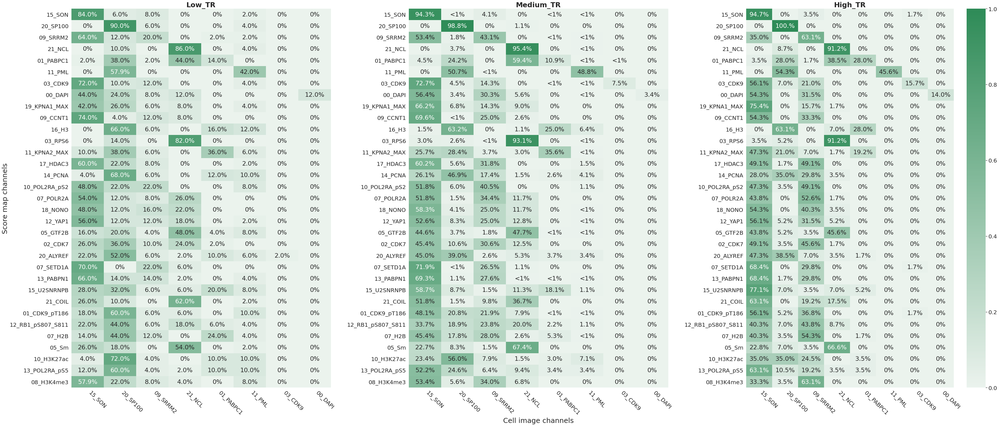

In [44]:
# get standard order of column
data = top_sm_to_ci_dfs[0].copy()
data['mapobject_id_cell'] = data['mapobject_id_cell'].astype(str)
data = data.merge(metadata_df[['mapobject_id_cell', 'set']],
                  left_on='mapobject_id_cell',
                  right_on='mapobject_id_cell',
                  how='left'
                  )
mask = data.set == 'test'
data = data[mask].copy()

temp_df = data.copy()
channel_counts = get_channel_counts(temp_df)
ordered_names = channel_counts.name.values
channels_wo_counts = set(input_channel_names).difference(ordered_names)
ordered_names = list(ordered_names) + list(channels_wo_counts)
    
temp_df = data.copy() 
temp_df.mapobject_id_cell = temp_df.mapobject_id_cell.astype(str)
temp_df = temp_df.merge(score_map_stddev[['mapobject_id_cell', 'cell_cycle', 'TR_Level']],
                  left_on='mapobject_id_cell',
                   right_on='mapobject_id_cell',
                   how='left'
                  )

filter_criteria = 'TR_Level'
filter_vals = ['Low_TR', 'Medium_TR', 'High_TR']

fig = plt.figure(figsize=(3*20, 25))
#plt.suptitle('Most similar cell image channels to score map channels divided by transcription rate', fontweight='bold', fontsize=30)
plt.subplots_adjust(wspace=0.3, hspace=0)

for i, filter_val in enumerate(filter_vals):
    title = filter_val

    mask = temp_df[filter_criteria] == filter_val
    plot_sim_matrix(temp_df[mask], ordered_names, 8, (15, 22), i, title, file_name='./'+filter_val+'_temp.jpg')

fig.savefig('./Similarity_SM_and_SM.JPG', bbox_inches='tight', pad_inches=0)

## 2.2.- Similarity between score_maps channels and score_maps chanels

[11  5  9 22 31 29 21 28  7 18  4 23 25 14 30 26  6 17 32 12 13  1  8]


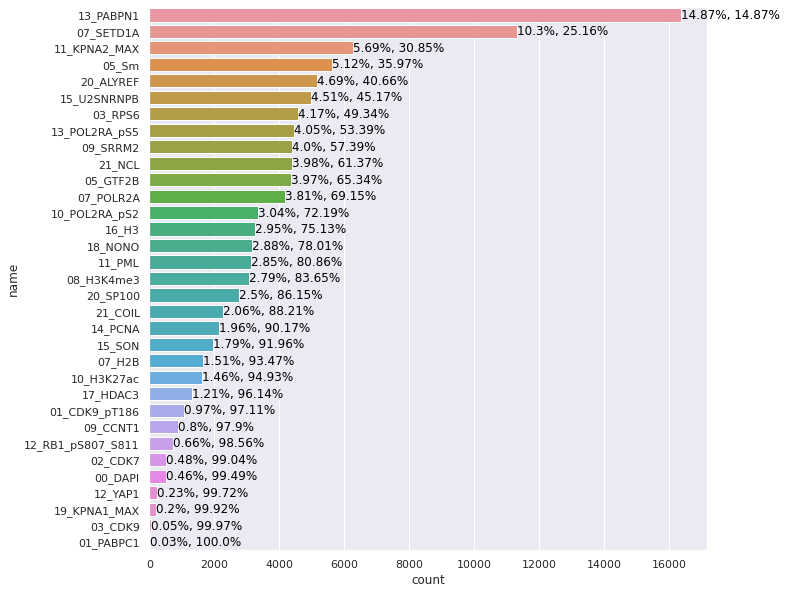

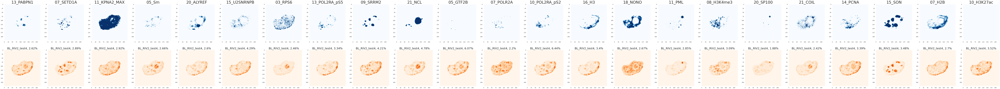

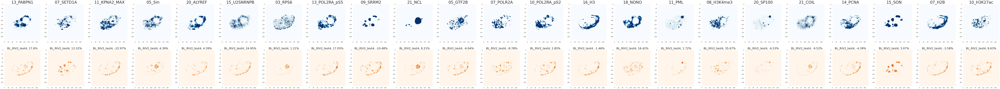

In [38]:
# Channels sorted by similarity counts
columns = [cn+'_idx' for cn in input_channel_names] + ['mapobject_id_cell']
temp_df = top_sm_to_sm_dfs[0].copy()
temp_df = temp_df[columns].set_index('mapobject_id_cell').stack()
temp_df = temp_df.reset_index()
temp_df.columns = ['mapobject_id_cell', 'channel', 'idx']

channel_counts = temp_df['idx'].value_counts().reset_index().copy()
channel_counts.columns = ['TFDS_channel_id', 'count']
total_counts = channel_counts['count'].sum()
channel_counts['percent'] = channel_counts['count'] / total_counts
channel_counts['cum_percent'] = channel_counts['count'].cumsum() / total_counts
channel_counts = channel_counts.merge(channels_df[['TFDS_channel_id', 'name']],
                             left_on='TFDS_channel_id',
                             right_on='TFDS_channel_id',
                             how='left'
                            )

plt.figure(figsize=(10,10))
g = sns.barplot(data=channel_counts,
            y='name',
            x='count',
            orient="h"
           )
# add per cents
for _, row in channel_counts.iterrows():
    text = str(round(100 * row.percent,2))+'%, '+str(round(100 * row.cum_percent,2))+'%'
    g.text(row['count'], row.name, text, color='black', ha="left", va="center")
    
# plot top channels
# take one cell from the sample
cell_id = '258520'
score_map = copy.deepcopy(cells[cell_id+'_sm'])
cell_img = copy.deepcopy(cells[cell_id+'_img'])
cell_mask = cells[cell_id+'_mask']
# select the most important channels
mask = channel_counts['cum_percent'] <= 0.95
names_channels_2_plot = channel_counts[mask].name.values
channels_2_plot = channels_df.set_index('name').loc[names_channels_2_plot].TFDS_channel_id.astype(np.int16).values
print(channels_2_plot)

nn_inter.plot_VarGrad_IG_2(img=cell_img,
                           img_mask=cell_mask,
                           score_maps={'BL_RIV2_test4': score_map},
                           top_percent=1,
                           channels_df=channels_df,
                           img_size=(7,7),
                           score_map_same_sacale=False,
                           channels_2_plot=channels_2_plot,
                           plot_overlap=False,
                           plot_colorbar=False,
                           plot_name=None#'./Plots/BL_VarGrad_'+cell+'_0_5.png'
                            )

# preprocessed image and score map
score_map = standardize_img(score_map, cell_mask)
cell_img = standardize_img(cell_img, cell_mask)
nn_inter.plot_VarGrad_IG_2(img=cell_img,
                           img_mask=cell_mask,
                           score_maps={'BL_RIV2_test4': score_map},
                           top_percent=1,
                           channels_df=channels_df,
                           img_size=(7,7),
                           score_map_same_sacale=False,
                           channels_2_plot=channels_2_plot,
                           plot_overlap=False,
                           plot_colorbar=False,
                           plot_name=None#'./Plots/BL_VarGrad_'+cell+'_0_5.png'
                            )

[11  5 25 22  7 23 29 31  9 28  4 18 15 30 14 21  6 12 13 32  2  8  1]


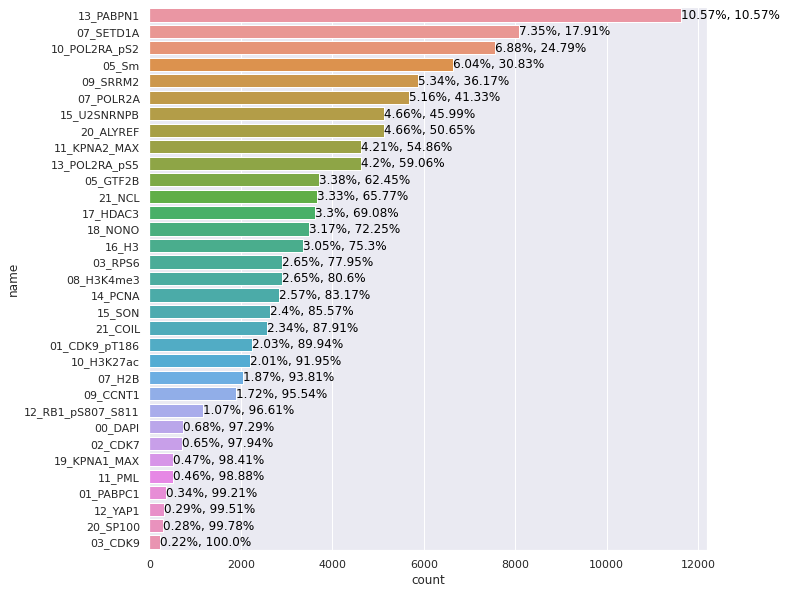

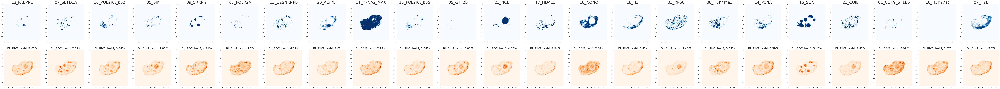

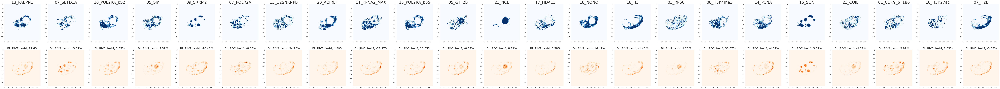

In [39]:
# Channels sorted by similarity counts
columns = [cn+'_idx' for cn in input_channel_names] + ['mapobject_id_cell']
temp_df = top_sm_to_sm_dfs[1].copy()
temp_df = temp_df[columns].set_index('mapobject_id_cell').stack()
temp_df = temp_df.reset_index()
temp_df.columns = ['mapobject_id_cell', 'channel', 'idx']

channel_counts = temp_df['idx'].value_counts().reset_index().copy()
channel_counts.columns = ['TFDS_channel_id', 'count']
total_counts = channel_counts['count'].sum()
channel_counts['percent'] = channel_counts['count'] / total_counts
channel_counts['cum_percent'] = channel_counts['count'].cumsum() / total_counts
channel_counts = channel_counts.merge(channels_df[['TFDS_channel_id', 'name']],
                             left_on='TFDS_channel_id',
                             right_on='TFDS_channel_id',
                             how='left'
                            )

plt.figure(figsize=(10,10))
g = sns.barplot(data=channel_counts,
            y='name',
            x='count',
            orient="h"
           )
# add per cents
for _, row in channel_counts.iterrows():
    text = str(round(100 * row.percent,2))+'%, '+str(round(100 * row.cum_percent,2))+'%'
    g.text(row['count'], row.name, text, color='black', ha="left", va="center")
    
# plot top channels
# take one cell from the sample
cell_id = '258520'
score_map = copy.deepcopy(cells[cell_id+'_sm'])
cell_img = copy.deepcopy(cells[cell_id+'_img'])
cell_mask = cells[cell_id+'_mask']
# select the most important channels
mask = channel_counts['cum_percent'] <= 0.95
names_channels_2_plot = channel_counts[mask].name.values
channels_2_plot = channels_df.set_index('name').loc[names_channels_2_plot].TFDS_channel_id.astype(np.int16).values
print(channels_2_plot)

nn_inter.plot_VarGrad_IG_2(img=cell_img,
                           img_mask=cell_mask,
                           score_maps={'BL_RIV2_test4': score_map},
                           top_percent=1,
                           channels_df=channels_df,
                           img_size=(7,7),
                           score_map_same_sacale=False,
                           channels_2_plot=channels_2_plot,
                           plot_overlap=False,
                           plot_colorbar=False,
                           plot_name=None#'./Plots/BL_VarGrad_'+cell+'_0_5.png'
                            )

# preprocessed image and score map
score_map = standardize_img(score_map, cell_mask)
cell_img = standardize_img(cell_img, cell_mask)
nn_inter.plot_VarGrad_IG_2(img=cell_img,
                           img_mask=cell_mask,
                           score_maps={'BL_RIV2_test4': score_map},
                           top_percent=1,
                           channels_df=channels_df,
                           img_size=(7,7),
                           score_map_same_sacale=False,
                           channels_2_plot=channels_2_plot,
                           plot_overlap=False,
                           plot_colorbar=False,
                           plot_name=None#'./Plots/BL_VarGrad_'+cell+'_0_5.png'
                            )

[23 11 15  5 25  7  4 29 31 28 32 30  9 13  2  6 14  8  1 12 22 21 19 24
 18]


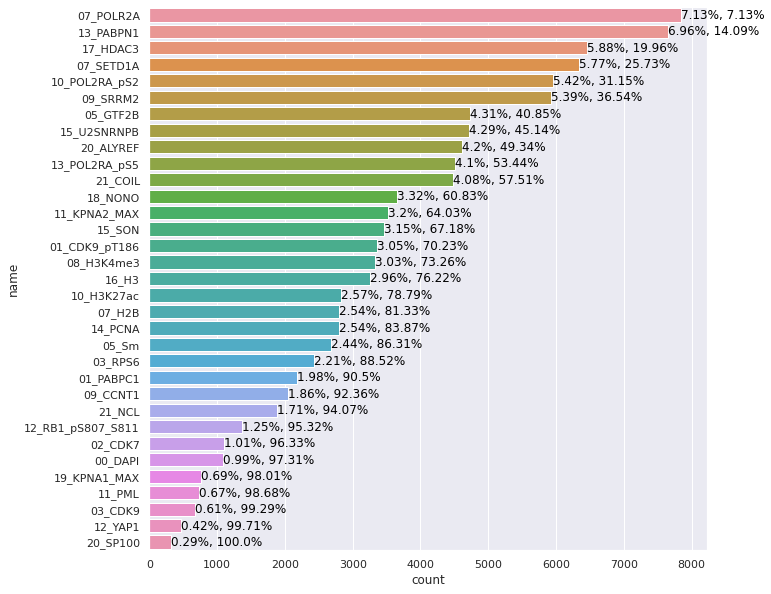

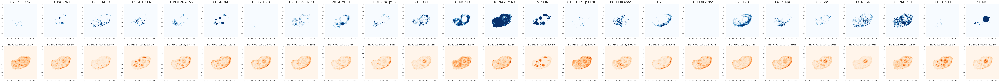

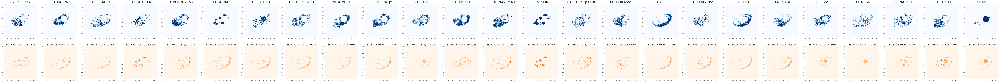

In [37]:
# Channels sorted by similarity counts
columns = [cn+'_idx' for cn in input_channel_names] + ['mapobject_id_cell']
temp_df = top_sm_to_sm_dfs[2].copy()
temp_df = temp_df[columns].set_index('mapobject_id_cell').stack()
temp_df = temp_df.reset_index()
temp_df.columns = ['mapobject_id_cell', 'channel', 'idx']

channel_counts = temp_df['idx'].value_counts().reset_index().copy()
channel_counts.columns = ['TFDS_channel_id', 'count']
total_counts = channel_counts['count'].sum()
channel_counts['percent'] = channel_counts['count'] / total_counts
channel_counts['cum_percent'] = channel_counts['count'].cumsum() / total_counts
channel_counts = channel_counts.merge(channels_df[['TFDS_channel_id', 'name']],
                             left_on='TFDS_channel_id',
                             right_on='TFDS_channel_id',
                             how='left'
                            )

plt.figure(figsize=(10,10))
g = sns.barplot(data=channel_counts,
            y='name',
            x='count',
            orient="h"
           )
# add per cents
for _, row in channel_counts.iterrows():
    text = str(round(100 * row.percent,2))+'%, '+str(round(100 * row.cum_percent,2))+'%'
    g.text(row['count'], row.name, text, color='black', ha="left", va="center")
    
# plot top channels
# take one cell from the sample
cell_id = '258520'
score_map = copy.deepcopy(cells[cell_id+'_sm'])
cell_img = copy.deepcopy(cells[cell_id+'_img'])
cell_mask = cells[cell_id+'_mask']
# select the most important channels
mask = channel_counts['cum_percent'] <= 0.95
names_channels_2_plot = channel_counts[mask].name.values
channels_2_plot = channels_df.set_index('name').loc[names_channels_2_plot].TFDS_channel_id.astype(np.int16).values
print(channels_2_plot)

nn_inter.plot_VarGrad_IG_2(img=cell_img,
                           img_mask=cell_mask,
                           score_maps={'BL_RIV2_test4': score_map},
                           top_percent=1,
                           channels_df=channels_df,
                           img_size=(7,7),
                           score_map_same_sacale=False,
                           channels_2_plot=channels_2_plot,
                           plot_overlap=False,
                           plot_colorbar=False,
                           plot_name=None#'./Plots/BL_VarGrad_'+cell+'_0_5.png'
                            )

# preprocessed image and score map
score_map = standardize_img(score_map, cell_mask)
cell_img = standardize_img(cell_img, cell_mask)
nn_inter.plot_VarGrad_IG_2(img=cell_img,
                           img_mask=cell_mask,
                           score_maps={'BL_RIV2_test4': score_map},
                           top_percent=1,
                           channels_df=channels_df,
                           img_size=(7,7),
                           score_map_same_sacale=False,
                           channels_2_plot=channels_2_plot,
                           plot_overlap=False,
                           plot_colorbar=False,
                           plot_name=None#'./Plots/BL_VarGrad_'+cell+'_0_5.png'
                            )

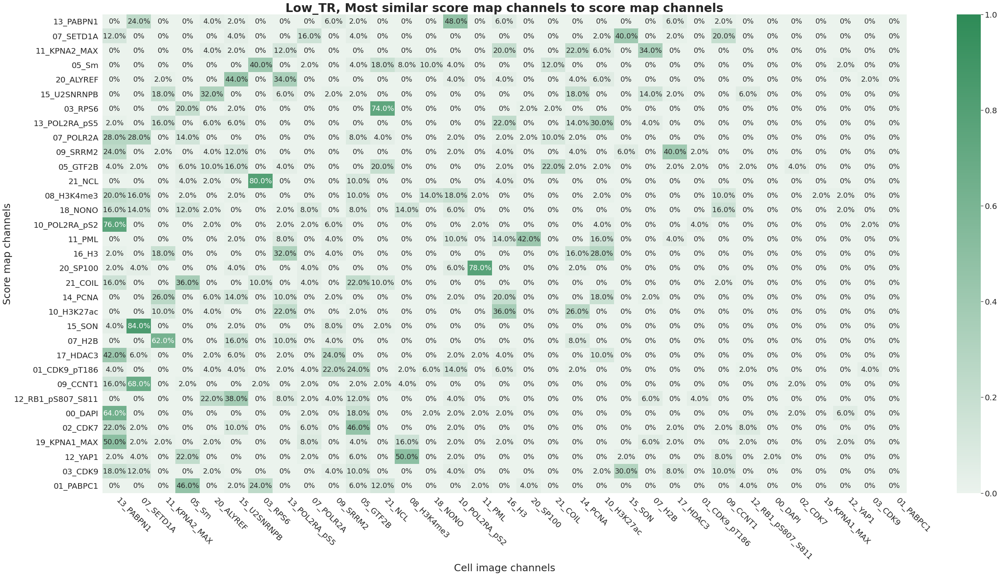

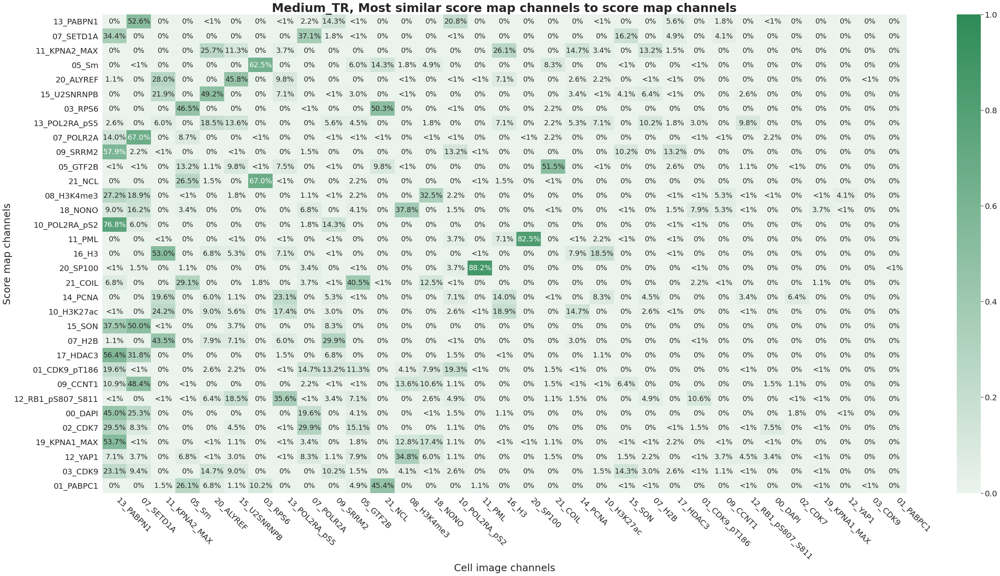

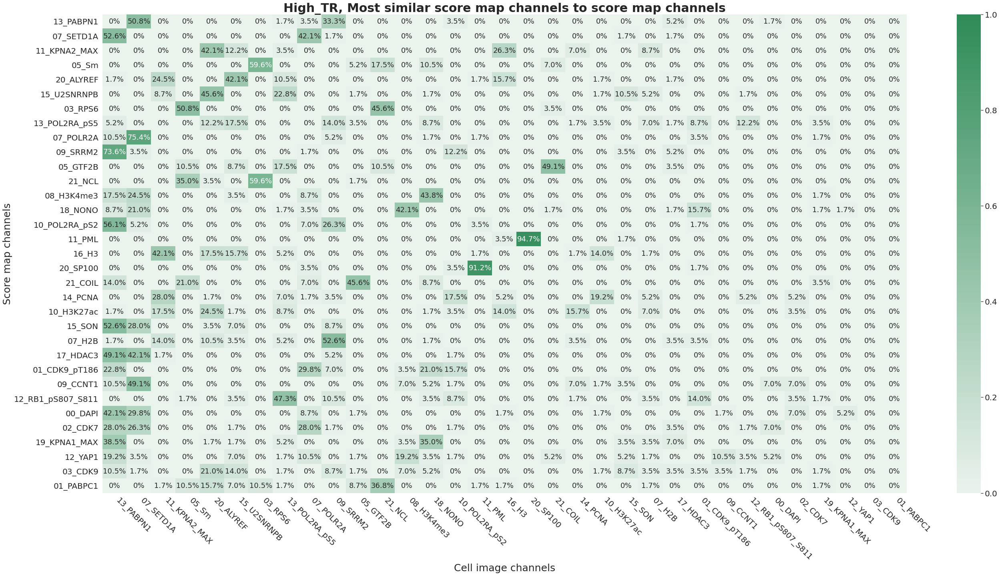

In [60]:
# get standard order of column
data = top_sm_to_sm_dfs[0].copy()
data = data.merge(metadata_df[['mapobject_id_cell', 'set']],
                  left_on='mapobject_id_cell',
                  right_on='mapobject_id_cell',
                  how='left'
                  )
mask = data.set == 'test'
data = data[mask].copy()

temp_df = data.copy()
channel_counts = get_channel_counts(temp_df)
ordered_names = channel_counts.name.values
    
temp_df = data.copy() 
temp_df.mapobject_id_cell = temp_df.mapobject_id_cell.astype(str)
temp_df = temp_df.merge(score_map_stddev[['mapobject_id_cell', 'cell_cycle', 'TR_Level']],
                  left_on='mapobject_id_cell',
                   right_on='mapobject_id_cell',
                   how='left'
                  )

filter_criteria = 'TR_Level'
filter_vals = ['Low_TR', 'Medium_TR', 'High_TR']

for filter_val in filter_vals:
    title = filter_val+', Most similar score map channels to score map channels'

    mask = temp_df[filter_criteria] == filter_val
    plot_sim_matrix(temp_df[mask], ordered_names, title, file_name='./'+filter_val+'_temp.jpg')

# Not important (To show in the presentation)

In [62]:
mask = targets_df.set == 'test'
mask |= targets_df.mapobject_id_cell.isin(black_list)
temp_df = targets_df[mask]
#np.random.seed(123)
np.random.seed(32)

# Sample cells with low TR
mask = temp_df.TR_Level == 'Low_TR'
mask &= temp_df.cell_cycle == 'G1'
low_tr_ids = temp_df[mask].mapobject_id_cell.values
np.random.shuffle(low_tr_ids)
low_tr_ids = low_tr_ids[0:5]

# Sample cells with avg TR
mask = temp_df.TR_Level == 'Medium_TR'
mask &= temp_df.cell_cycle == 'S'
avg_tr_ids = temp_df[mask].mapobject_id_cell.values
np.random.shuffle(avg_tr_ids)
avg_tr_ids = avg_tr_ids[0:5]

# Sample cells with high TR
mask = temp_df.TR_Level == 'High_TR'
mask &= temp_df.cell_cycle == 'G2'
high_tr_ids = temp_df[mask].mapobject_id_cell.values
np.random.shuffle(high_tr_ids)
high_tr_ids = high_tr_ids[0:5]

In [137]:
final_ids = list(low_tr_ids) + list(avg_tr_ids) + list(high_tr_ids) + ['258520', '208516', '262920'] + ['385343', '288743', '366408'] + ['258520', '261399', '280733']
#final_ids = ['258520', '261399', '280733'] # this are from the training and val data!
final_ids = ['277417', '321001', '195536'] # this are from the test data
mask = temp_df.mapobject_id_cell.isin(final_ids)
temp_df[mask]

,00_DAPI_idx,07_H2B_idx,01_CDK9_pT186_idx,03_CDK9_idx,05_GTF2B_idx,07_SETD1A_idx,08_H3K4me3_idx,09_SRRM2_idx,...,18_NONO_dist,20_ALYREF_dist,21_COIL_dist,mapobject_id_cell,cell_cycle,TR_Level,y,set
3389,7.0,7.0,7.0,7.0,18.0,7.0,7.0,7.0,...,0.663248,0.782212,0.704948,195536,G2,High_TR,540.086853,test
3521,7.0,7.0,7.0,3.0,13.0,7.0,7.0,7.0,...,0.544533,0.746505,0.662957,321001,S,Medium_TR,378.185364,test
3588,0.0,7.0,26.0,26.0,26.0,5.0,26.0,13.0,...,0.885716,0.867127,0.944508,277417,G1,Low_TR,133.040054,test


Opening cell: 195536, 1/3
['test']
Opening cell: 321001, 2/3
['test']
Opening cell: 277417, 3/3
['test']


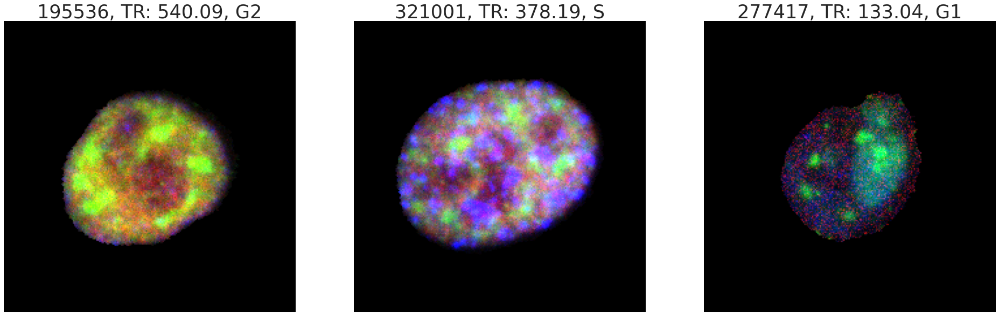

In [138]:
# Load cell, compute its Score map and save it
score_maps_dir = os.path.join(params['score_maps_path'], 'data')
#params['cells'] = big_cells
n_cells = len(final_ids)

plt.figure(figsize=(n_cells*11,10))
dss = [train_data, val_data, test_data]
ds_names = ['train', 'val', 'test']
cell_count = 0
cells = {}
for ds, dsn in zip(dss, ds_names):
    for cell in ds:
        # get cell id
        cell_id = cell['mapobject_id_cell'].numpy()
        cell_id = str(cell_id.decode())

        if cell_id in final_ids:
            cell_count += 1
            print('Opening cell: {}, {}/{}'.format(cell_id, cell_count, n_cells))
            
            cells[cell_id+'_img'] = cell['image'].numpy()
            cells[cell_id+'_img'] = cells[cell_id+'_img'][:,:,input_ids].astype(np.float32)
            
            cells[cell_id+'_mask'] = cell['image'].numpy()
            cells[cell_id+'_mask'] = cells[cell_id+'_mask'][:,:,-1]
            cells[cell_id+'_mask'] = cells[cell_id+'_mask'].astype(np.bool)
            
            cells[cell_id+'_tr'] = cell['target'].numpy()[0]
            
            # load score map
            temp_path = os.path.join(score_maps_dir, cell_id+'.npy')
            cells[cell_id+'_sm'] = np.load(temp_path)
            
            # Plot cells
            temp_img = copy.deepcopy(cells[cell_id+'_img'][:,:,10:13])
            temp_img = move_img_into_0_1(temp_img, cells[cell_id+'_mask'])
            
            plt.subplot(1, n_cells, cell_count)

            # Get TR
            TR = cells[cell_id+'_tr']
            # get cc
            mask = targets_df.mapobject_id_cell == cell_id
            cc = targets_df[mask].cell_cycle.values[0]
            print(targets_df[mask].set.values)

            nn_inter.plot_cell(img=temp_img, title=cell_id+', TR: '+str(round(TR, 2))+', '+cc, title_fontsize=35)

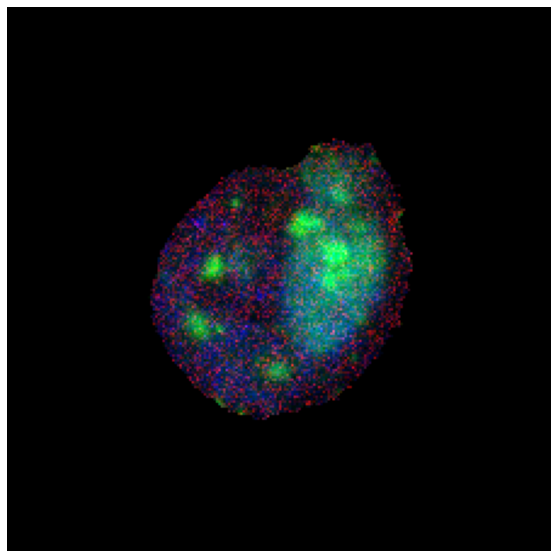

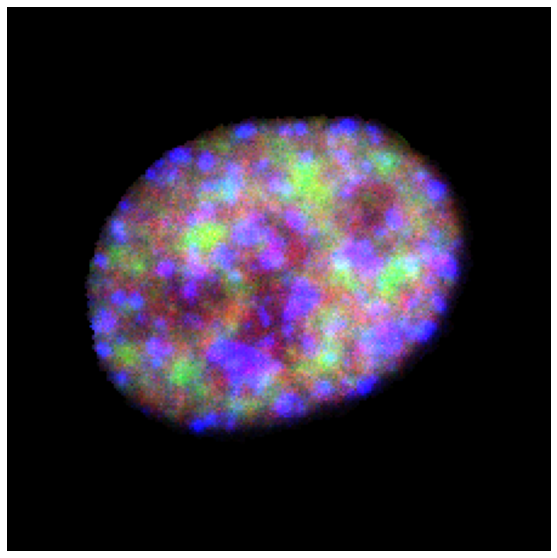

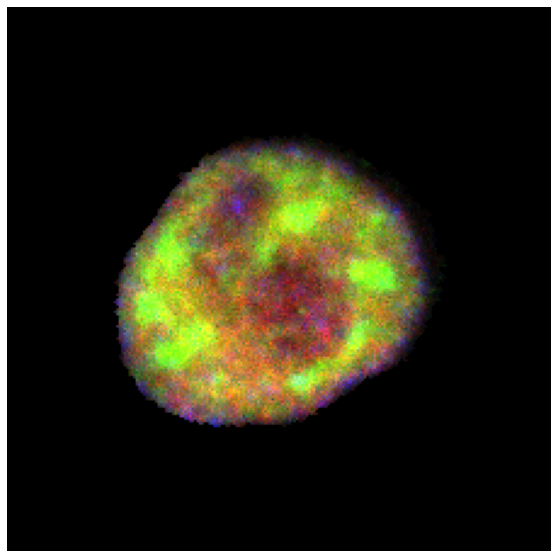

In [139]:
channel_ids = [10,11,12]
for cell_id in final_ids:
    # Plot cells
    temp_img = copy.deepcopy(cells[cell_id+'_img'][:,:,channel_ids])
    temp_img = move_img_into_0_1(temp_img, cells[cell_id+'_mask'])

    fig = plt.figure(figsize=(10,10))
    nn_inter.plot_cell(img=temp_img, title='', title_fontsize=35)
    fig.savefig('./'+cell_id+'.jpg', bbox_inches='tight', pad_inches=0)

In [140]:
#20_SP100
mask = channels_df.name.isin(['20_SP100', '09_SRRM2', '01_CDK9_pT186', '15_SON'])
channels_df[mask]

,original_channel_id,name,train_98_percentile,train_mean_after_clipping,train_stddev_after_clipping,type,TFDS_channel_id,channel_name
2,2.0,01_CDK9_pT186,46.889076,10.841645,10.662010,input,2.0,CDK9_pT186
7,7.0,09_SRRM2,273.374664,39.124294,58.492748,input,7.0,SRRM2
13,13.0,15_SON,243.390030,32.512615,51.612625,input,13.0,SON
17,17.0,20_SP100,219.365936,12.757618,36.084538,input,17.0,SP100


In [141]:
temp_df = top_sm_to_ci_dfs[0].copy()
temp_df.mapobject_id_cell = temp_df.mapobject_id_cell.astype(str)
temp_df = temp_df.merge(score_map_stddev[['mapobject_id_cell', 'cell_cycle', 'TR_Level', 'y', 'set']],
                  left_on='mapobject_id_cell',
                   right_on='mapobject_id_cell',
                   how='left'
                  )

mask = temp_df.TR_Level == 'Low_TR'
mask &= temp_df.cell_cycle == 'G1'
mask &= temp_df.set == 'test'
#mask &= temp_df['01_CDK9_pT186_idx'] == 17

temp_df[mask].sort_values(by='y').reset_index()

,index,00_DAPI_idx,07_H2B_idx,01_CDK9_pT186_idx,03_CDK9_idx,05_GTF2B_idx,07_SETD1A_idx,08_H3K4me3_idx,...,18_NONO_dist,20_ALYREF_dist,21_COIL_dist,mapobject_id_cell,cell_cycle,TR_Level,y,set
0,3588,0.0,7.0,26.0,26.0,26.0,5.0,26.0,...,0.885716,0.867127,0.944508,277417,G1,Low_TR,133.040054,test
1,3514,0.0,26.0,26.0,7.0,26.0,7.0,26.0,...,0.821208,0.873475,0.859727,195475,G1,Low_TR,172.002457,test
2,3492,13.0,17.0,13.0,13.0,17.0,13.0,13.0,...,0.534920,0.929690,0.632652,287066,G1,Low_TR,223.663910,test
3,3423,17.0,17.0,17.0,13.0,19.0,13.0,13.0,...,0.589821,0.820927,0.793690,248024,G1,Low_TR,239.751587,test
4,3539,18.0,17.0,17.0,13.0,18.0,13.0,17.0,...,0.807707,0.908039,0.730023,315244,G1,Low_TR,241.210251,test
5,3552,17.0,17.0,17.0,17.0,17.0,13.0,13.0,...,0.700133,0.793890,0.875346,266498,G1,Low_TR,242.415741,test
6,3502,18.0,19.0,17.0,13.0,18.0,13.0,17.0,...,0.814485,0.906828,0.703715,235381,G1,Low_TR,243.374939,test
7,3380,7.0,7.0,7.0,7.0,7.0,7.0,26.0,...,0.812150,0.817800,0.770855,210126,G1,Low_TR,249.408234,test
8,3347,0.0,7.0,13.0,13.0,13.0,13.0,13.0,...,0.829988,0.807682,0.786325,210655,G1,Low_TR,250.241791,test
9,3689,13.0,13.0,13.0,13.0,13.0,7.0,7.0,...,0.441466,0.850000,0.677885,383750,G1,Low_TR,252.522110,test


In [142]:
mask = temp_df.TR_Level == 'Medium_TR'
mask &= temp_df.cell_cycle == 'S'
mask &= temp_df.set == 'test'
#mask &= temp_df['01_CDK9_pT186_idx'] == 17

temp_df[mask].sort_values(by='y').reset_index().iloc[27]

index                      3521
00_DAPI_idx                 7.0
07_H2B_idx                  7.0
01_CDK9_pT186_idx           7.0
03_CDK9_idx                 3.0
                        ...    
mapobject_id_cell        321001
cell_cycle                    S
TR_Level              Medium_TR
y                    378.185364
set                        test
Name: 27, Length: 72, dtype: object

In [143]:
mask = temp_df.TR_Level == 'High_TR'
mask &= temp_df.cell_cycle == 'G2'
mask &= temp_df.set == 'test'
#mask &= temp_df['01_CDK9_pT186_idx'] == 13

temp_df[mask].sort_values(by='y').reset_index()

,index,00_DAPI_idx,07_H2B_idx,01_CDK9_pT186_idx,03_CDK9_idx,05_GTF2B_idx,07_SETD1A_idx,08_H3K4me3_idx,...,18_NONO_dist,20_ALYREF_dist,21_COIL_dist,mapobject_id_cell,cell_cycle,TR_Level,y,set
0,3425,7.0,13.0,13.0,13.0,13.0,13.0,7.0,...,0.531734,0.777465,0.586866,271189,G2,High_TR,439.234192,test
1,3651,13.0,13.0,13.0,13.0,13.0,13.0,13.0,...,0.425922,0.791365,0.513849,324772,G2,High_TR,439.428131,test
2,3578,13.0,7.0,13.0,13.0,13.0,13.0,13.0,...,0.489466,0.777417,0.507964,200718,G2,High_TR,439.446045,test
3,3536,0.0,7.0,7.0,7.0,13.0,7.0,7.0,...,0.508772,0.805812,0.764880,350947,G2,High_TR,439.639954,test
4,3362,13.0,13.0,13.0,3.0,13.0,13.0,13.0,...,0.601837,0.797274,0.633224,378132,G2,High_TR,442.804565,test
5,3495,13.0,7.0,13.0,3.0,13.0,13.0,7.0,...,0.593460,0.864182,0.665605,249299,G2,High_TR,450.264740,test
6,3551,13.0,7.0,13.0,13.0,18.0,13.0,7.0,...,0.582130,0.761831,0.676319,195503,G2,High_TR,453.414276,test
7,3491,13.0,7.0,13.0,13.0,13.0,13.0,13.0,...,0.596235,0.780084,0.591884,307723,G2,High_TR,475.633698,test
8,3619,7.0,13.0,13.0,13.0,7.0,7.0,7.0,...,0.468433,0.798031,0.603097,377480,G2,High_TR,502.077271,test
9,3561,0.0,7.0,7.0,7.0,21.0,13.0,7.0,...,0.471984,0.847620,0.798778,208501,G2,High_TR,505.954681,test


[25  4  7 18 11  5 13 17 26]


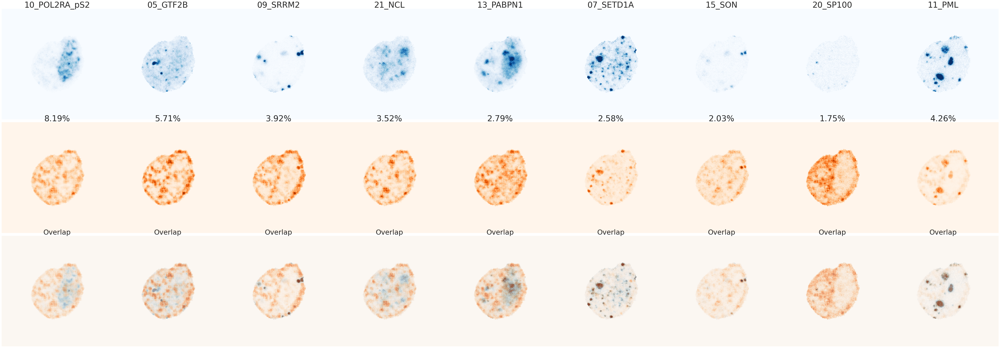

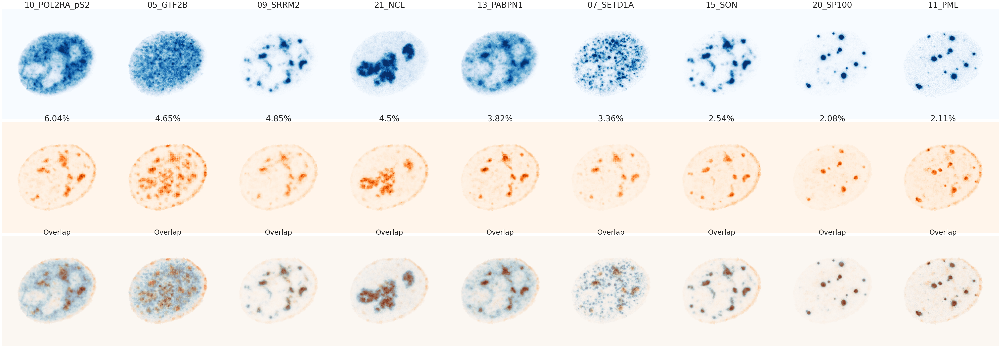

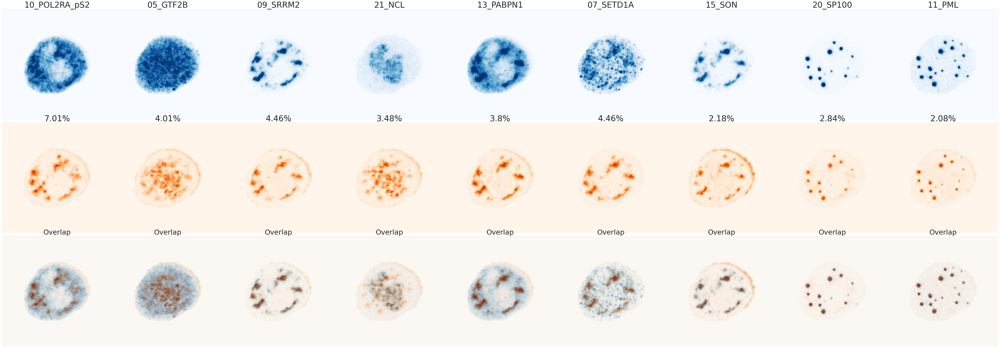

In [616]:
selected_ids = final_ids

names_channels_2_plot = ['10_POL2RA_pS2', '05_GTF2B', '09_SRRM2', '21_NCL', '21_COIL', '13_PABPN1', '07_SETD1A', '03_RPS6', '15_U2SNRNPB', '05_Sm']
names_channels_2_plot = ['15_SON', '20_SP100', '21_NCL', '09_SRRM2', '01_PABPC1', '11_PML', '03_CDK9', '10_POL2RA_pS2', '01_CDK9_pT186']
names_channels_2_plot = ['10_POL2RA_pS2', '05_GTF2B', '09_SRRM2', '21_NCL', '15_SON', '11_PML', '20_SP100', '01_PABPC1', '01_CDK9_pT186']
names_channels_2_plot = ['10_POL2RA_pS2', '05_GTF2B', '09_SRRM2', '21_NCL', '13_PABPN1', '07_SETD1A', '15_SON', '20_SP100', '11_PML']
channels_2_plot = channels_df.set_index('name').loc[names_channels_2_plot].TFDS_channel_id.astype(np.int16).values
print(channels_2_plot)

n_cells = len(selected_ids)
#plt.figure(figsize=(n_cells*10,10))

for i, cell_id in enumerate(selected_ids,1):
    temp_img = copy.deepcopy(cells[cell_id+'_img'])
    temp_mask = cells[cell_id+'_mask']
    temp_sm = copy.deepcopy(cells[cell_id+'_sm'])
    TR = cells[cell_id+'_tr']

    temp_img = move_img_into_0_1(temp_img, temp_mask)
    #temp_sm = move_img_into_0_1(temp_sm, temp_mask)
    
    #plt.subplot(1, n_cells, i)
    #nn_inter.plot_cell(img=temp_img[:,:,10:13], title=cell_id+', TR: '+str(round(TR, 2)), title_fontsize=18)

    nn_inter.plot_VarGrad_IG_2(img=temp_img,
                               img_mask=temp_mask,
                               score_maps={'BL_RIV2_test4': temp_sm},
                               top_percent=1,
                               channels_df=channels_df,
                               img_size=(9,9),
                               score_map_same_sacale=False,
                               channels_2_plot=channels_2_plot,
                               plot_overlap=True,
                               plot_colorbar=False,
                               plot_name='./BL_VarGrad_'+cell_id+'.png'
                                )